# Setting Source Folder

In [1]:
import os, sys

filedir = os.path.abspath(".")

currentdir = os.path.dirname(os.path.abspath(".")) # workaround to adding local modules

parentdir = os.path.dirname(os.path.abspath(""+currentdir))
print(f'CurrentDir: {currentdir}')
print(f'ParentDir: {parentdir}')

sys.path.insert(0, currentdir)

CurrentDir: /Users/renan.cristofalo/Documents/git/multimorbity_use
ParentDir: /Users/renan.cristofalo/Documents/git


# IMPORTAÇÃO DAS BIBLIOTECAS

In [2]:
# pip install tensorflow-metal==0.5.0 tensorflow-macos==2.9

In [3]:
# What version of Python do you have?
import sys

import tensorflow.keras
import pandas as pd
import sklearn as sk
import tensorflow as tf
import platform

print(f"Python Platform: {platform.platform()}")
print(f"Tensor Flow Version: {tf.__version__}")
print(f"Keras Version: {tensorflow.keras.__version__}")
print()
print(f"Python {sys.version}")
print(f"Pandas {pd.__version__}")
print(f"Scikit-Learn {sk.__version__}")
gpu = len(tf.config.list_physical_devices('GPU'))>0
print("GPU is", "available" if gpu else "NOT AVAILABLE")

# For M1 computers = https://www.youtube.com/watch?v=5DgWvU0p2bk&ab_channel=JeffHeaton

Python Platform: macOS-13.5.2-arm64-arm-64bit
Tensor Flow Version: 2.9.0
Keras Version: 2.9.0

Python 3.9.15 | packaged by conda-forge | (main, Nov 22 2022, 08:48:25) 
[Clang 14.0.6 ]
Pandas 1.3.0
Scikit-Learn 1.1.2
GPU is available


In [4]:
import pandas as pd
import numpy as np
import joblib
import os.path as osp
import logging

from src.visualization.data_visualization import *
from src.ml.model_selection import cross_validate_models, _create_metric_msg, create_df_results, RandomizedSearch, make_dnn_model
from src.ml.utils.preprocessors import select_preprocessor
from src.ml.utils.utils import write_joblib, read_joblib
from src.utils.utils import now_str
from src.ml.evaluation.evaluate import get_metric_result
from src.config import *

from sklearn.preprocessing import MinMaxScaler,StandardScaler, FunctionTransformer, PowerTransformer

from sklearn.pipeline import Pipeline
from sklearn.base import clone

from scikeras.wrappers import KerasClassifier

#Models
from sklearn.dummy import DummyClassifier
from sklearn.linear_model import RidgeClassifier, LogisticRegression
from xgboost import XGBClassifier
from lightgbm import LGBMClassifier, LGBMRegressor #conda install lightgbm==3.3.2
from catboost import CatBoostClassifier
# from ngboost import NGBClassifier
from sklearn.ensemble import RandomForestClassifier, GradientBoostingClassifier, ExtraTreesClassifier, VotingClassifier, StackingClassifier
from sklearn.tree import DecisionTreeClassifier


from tensorflow.python.keras.callbacks import EarlyStopping, ReduceLROnPlateau, ModelCheckpoint

# explicitly require this experimental feature
from sklearn.experimental import enable_iterative_imputer
from sklearn.impute import IterativeImputer, SimpleImputer

# import packages for imbalanced learn
from imblearn.combine import SMOTEENN
from imblearn.pipeline import Pipeline as Imb_Pipeline
from imblearn.ensemble import RUSBoostClassifier, BalancedRandomForestClassifier

import warnings
warnings.filterwarnings("ignore")

pd.options.display.float_format = '{:,.2f}'.format
%matplotlib inline

In [5]:
N_FOLDS = 10
SEED=123
MODELS_DIR = osp.join('models','v1')


# Definining Logs

In [6]:
def define_logs(logs_path):
    """ Define the logs for the model selector

    Args:
        logs_path (str): Path to the log file
    """
    folder_path = osp.dirname(osp.abspath(logs_path))
    if not osp.exists(folder_path):
        os.makedirs(folder_path)

    log = logging.getLogger()
    log.setLevel(logging.INFO)
    fh = logging.FileHandler(filename=logs_path)
    fh.setLevel(logging.INFO)
    formatter = logging.Formatter(
                    fmt='%(asctime)s %(levelname)s: %(message)s',
                    datefmt='%Y-%m-%d %H:%M:%S'
                    )
    fh.setFormatter(formatter)
    log.addHandler(fh)
    
    return log

In [7]:
logger = define_logs(osp.join(MODELS_DIR,'logs',f'{now_str()}-model_selection.logs'))

In [8]:
import json
def is_jsonable(x):
    try:
        json.dumps(x)
        return True
    except (TypeError, OverflowError):
        return False

# Model Training

## Defining Strategies

In [36]:
ALL_PATH = osp.join ('..','data','feature_selection', 'raw')
BORUTA_PATH = osp.join ('..','data','feature_selection', 'boruta')
FS_PATH = osp.join ('..','data','feature_selection', 'fs')
FM_PATH = osp.join ('..','data','feature_selection', 'FM')
FM_MUST_PATH = osp.join ('..','data','feature_selection', 'FM_MUST')
FS_MUST_PATH = osp.join ('..','data','feature_selection', 'fs_must')

STRATEGIES = {

    'ALL_FEATURES':{ 
        'description': "Training with all available features",
        'df_train' : osp.join(ALL_PATH, 'df_train.parquet'),
        'df_test' : osp.join(ALL_PATH, 'df_test.parquet'),
    },
    
    'BORUTA':{ 
        'description': "Training with features selected by the Boruta Feature Selection",
        'df_train' : osp.join(BORUTA_PATH, 'df_train.parquet'),
        'df_test' : osp.join(BORUTA_PATH, 'df_test.parquet'),
    },
    
    'FS':{ 
        'description': "Training with features selected by the Feature Selector",
        'df_train' : osp.join(FS_PATH, 'df_train.parquet'),
        'df_test' : osp.join(FS_PATH, 'df_test.parquet'),
    },
       
    'FM':{ 
        'description': "Training with features selected by the Feature Selector",
        'df_train' : osp.join(FM_PATH, 'df_train.parquet'),
        'df_test' : osp.join(FM_PATH, 'df_test.parquet'),
    },
       
    'FM_MUST':{ 
        'description': "Training with features selected by the Feature Selector",
        'df_train' : osp.join(FM_MUST_PATH, 'df_train.parquet'),
        'df_test' : osp.join(FM_MUST_PATH, 'df_test.parquet'),
    },
       
    'FS_MUST':{ 
        'description': "Training with filtered features selected by the Feature Selector combined with sampler SMOTEENN",
        'df_train' : osp.join(FS_MUST_PATH, 'df_train.parquet'),
        'df_test' : osp.join(FS_MUST_PATH, 'df_test.parquet'),
    }
}
for strategy, dict_strategy in STRATEGIES.items():
    logger.info(f'\n*************** {strategy} ***************\n')  
    logger.info(json.dumps({k:(str(v) if not is_jsonable(v) else v) for k,v in dict_strategy.items()} , sort_keys = False, indent = 3, skipkeys=True))
    
    # getting strategy parameters
    df_train_path = dict_strategy.get('df_train', None)
    df_test_path = dict_strategy.get('df_test', None)
    
    # reading files
    df_train=pd.read_parquet(df_train_path)
    df_test=pd.read_parquet(df_test_path)
    
    logger.info(f'\ndf_train shape: {df_train.shape} \n df_test shape: {df_test.shape}\n')

## Defining Metrics

In [27]:
metrics={
        'accuracy'      :   'accuracy',
        'balanced_acc'  :   'balanced_accuracy',
        'F1'            :   'f1',
        'Precision'     :   'precision',
        'recall'        :   'recall',
        'roc_auc'       :   'roc_auc',
        } 

## Defining Sklearn Models

In [28]:
models = []

# Make a pipeline for the model, scaling and making a cross validation for each of them
models.append({'name':"Dummy"
             , 'model': DummyClassifier()
             })

models.append({'name':"LogisticRegression"
             , 'model': LogisticRegression()
             })

models.append({'name':"DecisionTreeClassifier"
             , 'model': DecisionTreeClassifier(min_samples_split=0.005, min_samples_leaf=0.001,random_state=SEED)
             })

models.append({'name':"RandomForestClassifier"
             , 'model': RandomForestClassifier(max_depth = 7, random_state = SEED, min_samples_split = 0.01, min_samples_leaf = 0.005)
             })

models.append({'name':"ExtraTreesClassifier"
             , 'model': ExtraTreesClassifier(max_depth = 7, random_state = SEED, min_samples_split = 0.01, min_samples_leaf = 0.005)
             })

models.append({'name':"GradientBoostingClassifier"
             , 'model': GradientBoostingClassifier(max_depth = 7, random_state = SEED, min_samples_split = 0.01, min_samples_leaf = 0.005)
             }) 

models.append({'name':"XGBoostClassifier"
             , 'model': XGBClassifier(max_depth = 7, random_state = SEED)
             }) 

models.append({'name':"XGBoostClassifier_Default"
             , 'model': XGBClassifier(random_state = SEED)
             }) 

models.append({'name':"LGBMClassifier"
             , 'model': LGBMClassifier(max_depth = 7, verbose=0, random_state = SEED)
             }) 

models.append({'name':"LGBMClassifier_Default"
             , 'model': LGBMClassifier(random_state = SEED)
             }) 

models.append({'name':"CatBoostClassifier"
             , 'model': CatBoostClassifier(max_depth = 7, verbose=0, random_state = SEED)
             }) 

models.append({'name':"CatBoostClassifier_Default"
             , 'model': CatBoostClassifier(random_state = SEED)
             }) 

models.append({'name':"BalancedRandomForestClassifier"
             , 'model': BalancedRandomForestClassifier(random_state = SEED)
             }) 

models.append({'name':"RUSBoostClassifier"
             , 'model': RUSBoostClassifier(random_state = SEED)
             }) 

models.append({'name':"VotingClassifier"
             , 'model': VotingClassifier(estimators = [
                ('rf', RandomForestClassifier(n_estimators=10, random_state=42)),
                ('lgbm', LGBMClassifier(max_depth=10)),
                ('catboost',CatBoostClassifier(max_depth=10, verbose=False)),
                ('xgboost',XGBClassifier(max_depth=10, random_state = SEED)),
            ], voting = 'soft')
            }) 

models.append({'name':"StackingClassifier"
             , 'model': StackingClassifier(estimators = [
                ('rf', RandomForestClassifier(n_estimators=10, random_state=42)),
                ('xgboost',XGBClassifier(max_depth=10, random_state = SEED)),
                ('lgbm', LGBMClassifier(max_depth=10)),
            ])
            }) 


## Defining Tensorflow Models

In [29]:
# models = []

PATIENCE=5
NUM_EPOCHS = 30

BATCH_SIZE=1024
seed = 42
verbose=0


callbacks ={
'EarlyStopping': tf.keras.callbacks.EarlyStopping,
}
tf_metrics = ['accuracy'] #https://www.tensorflow.org/api_docs/python/tf/keras/metrics

models.append({'name':"DNN_01"
             , 'model': KerasClassifier(
               model = make_dnn_model,
               optimizer = 'adam',
               network_layers = (1024, 1024, 512, 512),
               dropout_rate = 0.3,
               epochs=NUM_EPOCHS,
               batch_size = BATCH_SIZE,
               callbacks=callbacks,
               callbacks__EarlyStopping__monitor='val_loss', 
               callbacks__EarlyStopping__patience=PATIENCE, 
               callbacks__EarlyStopping__restore_best_weights=True,
               validation_split=1/N_FOLDS,
               verbose=0
               )
             }) 

models.append({'name':"DNN_02"
             , 'model': KerasClassifier(
               model = make_dnn_model,
               optimizer = 'adam',
               network_layers = (1024, 512, 256, 128, 64, 32),
               dropout_rate = 1/N_FOLDS,
               epochs=NUM_EPOCHS,
               batch_size = BATCH_SIZE,
               callbacks=callbacks,
               callbacks__EarlyStopping__monitor='val_loss', 
               callbacks__EarlyStopping__patience=PATIENCE, 
               callbacks__EarlyStopping__restore_best_weights=True,
               validation_split=1/N_FOLDS,
               verbose=0
               )
             }) 

models.append({'name':"DNN_03"
             , 'model': KerasClassifier(
               model = make_dnn_model,
               optimizer = 'adam',
               network_layers = (128, 64, 32),
               dropout_rate = 0.1,
               epochs=NUM_EPOCHS,
               batch_size = BATCH_SIZE,
               callbacks=callbacks,
               callbacks__EarlyStopping__monitor='val_loss', 
               callbacks__EarlyStopping__patience=PATIENCE, 
               callbacks__EarlyStopping__restore_best_weights=True,
               validation_split=1/N_FOLDS,
               verbose=0
               )
             }) 

models.append({'name':"DNN_04"
             , 'model': KerasClassifier(
               model = make_dnn_model,
               optimizer = 'adam',
               network_layers = (32, 16, 8),
               dropout_rate = 0.1,
               epochs=NUM_EPOCHS,
               batch_size = BATCH_SIZE,
               callbacks=callbacks,
               callbacks__EarlyStopping__monitor='val_loss', 
               callbacks__EarlyStopping__patience=PATIENCE, 
               callbacks__EarlyStopping__restore_best_weights=True,
               validation_split=1/N_FOLDS,
               verbose=0
               )
             }) 


models.append({'name':"VotingClassifierDNN_01"
             , 'model': VotingClassifier(estimators = [
                ('rf', RandomForestClassifier(n_estimators=10, random_state=42)),
                ('lgbm', LGBMClassifier(max_depth=10)),
                ('DNN_01',KerasClassifier(
               model = make_dnn_model,
               optimizer = 'adam',
               network_layers = (1024, 1024, 512, 512),
               dropout_rate = 0.3,
               epochs=NUM_EPOCHS,
               batch_size = BATCH_SIZE,
               callbacks=callbacks,
               callbacks__EarlyStopping__monitor='val_loss', 
               callbacks__EarlyStopping__patience=PATIENCE, 
               callbacks__EarlyStopping__restore_best_weights=True,
               validation_split=1/N_FOLDS,
               verbose=0
               )),
            ], voting = 'soft')
            }) 



## Running Models' Training

In [30]:
for strategy, dict_strategy in STRATEGIES.items():
    
    # logging strategy
    logger.info(f'*************** {strategy} ***************')  
    logger.info(json.dumps({k:(str(v) if not is_jsonable(v) else v)for k,v in dict_strategy.items() } , sort_keys = False, indent = 4, skipkeys=True))
      
    # getting strategy parameters
    df_train_path = dict_strategy.get('df_train', None)
    df_test_path = dict_strategy.get('df_test', None)
    imbalanced_sampler = dict_strategy.get('imbalanced_sampler', None)
    
    # reading files
    df_train=pd.read_parquet(df_train_path)
    df_test=pd.read_parquet(df_test_path)
    
    logger.info(f'df_train shape: {df_train.shape}')
    logger.info(f'df_test shape: {df_test.shape}')   
    
    X_train_= df_train.drop([TARGET], axis=1)
    y_train_ = df_train[TARGET]
    X_test_ = df_test.drop([TARGET], axis=1)
    y_test_ = df_test[TARGET]

    # Adding preprocessor
    preprocessor = None
    preprocessor = select_preprocessor('TargetEncoding', X = X_train_)
    
    strategy_models = []
    if imbalanced_sampler:
        df_train=pd.read_parquet(df_train_path).sample(10000)
        X_train_= df_train.drop([TARGET], axis=1)
        y_train_ = df_train[TARGET]
        
        for model in models:
            strategy_models.append({
                'name': strategy + '_' + model['name'],
                'model': Imb_Pipeline(steps = [
                    ('preprocessor', preprocessor),
                    ('sampling', imbalanced_sampler),
                    ('model', model['model'])
                ])
            })
    else:
        for model in models:
            strategy_models.append({
                'name': strategy + '_' + model['name'],
                'model': Pipeline(steps = [
                    ('preprocessor', preprocessor),
                    ('model', model['model'])
                ])
            })
    
    names, results, df_results = cross_validate_models(
        models = strategy_models
        , X_train = X_train_
        , y_train = y_train_
        , X_test = X_test_
        , y_test = y_test_
        , metrics = metrics
        , n_folds = N_FOLDS
        , models_dir = MODELS_DIR
        )

  0%|          | 0/21 [00:00<?, ?it/s]

  5%|▍         | 1/21 [00:01<00:24,  1.24s/it]


AVERAGES - FM_DUMMY:
 - ACCURACY               ->  - TRAIN: 0.52 (+/- 0.00) | VALIDATION: 0.52 (+/- 0.00) | TEST: 0.47 (+/- 0.00)
 - BALANCED_ACC           ->  - TRAIN: 0.50 (+/- 0.00) | VALIDATION: 0.50 (+/- 0.00) | TEST: 0.50 (+/- 0.00)
 - F1                     ->  - TRAIN: 0.00 (+/- 0.00) | VALIDATION: 0.00 (+/- 0.00) | TEST: 0.00 (+/- 0.00)
 - PRECISION              ->  - TRAIN: 0.00 (+/- 0.00) | VALIDATION: 0.00 (+/- 0.00) | TEST: 0.00 (+/- 0.00)
 - RECALL                 ->  - TRAIN: 0.00 (+/- 0.00) | VALIDATION: 0.00 (+/- 0.00) | TEST: 0.00 (+/- 0.00)
 - ROC_AUC                ->  - TRAIN: 0.50 (+/- 0.00) | VALIDATION: 0.50 (+/- 0.00) | TEST: 0.50 (+/- 0.00)
 - FIT TIME FOR EACH FOLD ->  - TRAIN: 0.04s (+/- 0.02s)



 10%|▉         | 2/21 [00:02<00:24,  1.28s/it]


AVERAGES - FM_LOGISTICREGRESSION:
 - ACCURACY               ->  - TRAIN: 0.68 (+/- 0.00) | VALIDATION: 0.56 (+/- 0.03) | TEST: 0.53 (+/- 0.01)
 - BALANCED_ACC           ->  - TRAIN: 0.68 (+/- 0.00) | VALIDATION: 0.56 (+/- 0.03) | TEST: 0.54 (+/- 0.01)
 - F1                     ->  - TRAIN: 0.65 (+/- 0.01) | VALIDATION: 0.52 (+/- 0.04) | TEST: 0.53 (+/- 0.01)
 - PRECISION              ->  - TRAIN: 0.68 (+/- 0.00) | VALIDATION: 0.55 (+/- 0.03) | TEST: 0.57 (+/- 0.01)
 - RECALL                 ->  - TRAIN: 0.62 (+/- 0.01) | VALIDATION: 0.50 (+/- 0.04) | TEST: 0.50 (+/- 0.02)
 - ROC_AUC                ->  - TRAIN: 0.76 (+/- 0.00) | VALIDATION: 0.59 (+/- 0.03) | TEST: 0.55 (+/- 0.01)
 - FIT TIME FOR EACH FOLD ->  - TRAIN: 0.05s (+/- 0.01s)



 14%|█▍        | 3/21 [00:03<00:22,  1.24s/it]


AVERAGES - FM_DECISIONTREECLASSIFIER:
 - ACCURACY               ->  - TRAIN: 0.86 (+/- 0.00) | VALIDATION: 0.56 (+/- 0.02) | TEST: 0.54 (+/- 0.01)
 - BALANCED_ACC           ->  - TRAIN: 0.86 (+/- 0.00) | VALIDATION: 0.55 (+/- 0.02) | TEST: 0.54 (+/- 0.01)
 - F1                     ->  - TRAIN: 0.85 (+/- 0.00) | VALIDATION: 0.53 (+/- 0.03) | TEST: 0.53 (+/- 0.01)
 - PRECISION              ->  - TRAIN: 0.87 (+/- 0.01) | VALIDATION: 0.54 (+/- 0.03) | TEST: 0.58 (+/- 0.01)
 - RECALL                 ->  - TRAIN: 0.82 (+/- 0.01) | VALIDATION: 0.52 (+/- 0.04) | TEST: 0.49 (+/- 0.02)
 - ROC_AUC                ->  - TRAIN: 0.95 (+/- 0.00) | VALIDATION: 0.57 (+/- 0.03) | TEST: 0.56 (+/- 0.01)
 - FIT TIME FOR EACH FOLD ->  - TRAIN: 0.04s (+/- 0.00s)


AVERAGES - FM_RANDOMFORESTCLASSIFIER:
 - ACCURACY               ->  - TRAIN: 0.74 (+/- 0.00) | VALIDATION: 0.61 (+/- 0.02) | TEST: 0.57 (+/- 0.01)
 - BALANCED_ACC           ->  - TRAIN: 0.74 (+/- 0.01) | VALIDATION: 0.61 (+/- 0.02) | TEST: 0.57 (+/

 19%|█▉        | 4/21 [00:07<00:37,  2.23s/it]


AVERAGES - FM_EXTRATREESCLASSIFIER:
 - ACCURACY               ->  - TRAIN: 0.68 (+/- 0.00) | VALIDATION: 0.56 (+/- 0.02) | TEST: 0.52 (+/- 0.01)
 - BALANCED_ACC           ->  - TRAIN: 0.68 (+/- 0.00) | VALIDATION: 0.56 (+/- 0.02) | TEST: 0.53 (+/- 0.01)
 - F1                     ->  - TRAIN: 0.65 (+/- 0.01) | VALIDATION: 0.51 (+/- 0.03) | TEST: 0.51 (+/- 0.02)
 - PRECISION              ->  - TRAIN: 0.70 (+/- 0.01) | VALIDATION: 0.55 (+/- 0.02) | TEST: 0.56 (+/- 0.01)
 - RECALL                 ->  - TRAIN: 0.61 (+/- 0.02) | VALIDATION: 0.47 (+/- 0.03) | TEST: 0.47 (+/- 0.02)
 - ROC_AUC                ->  - TRAIN: 0.77 (+/- 0.00) | VALIDATION: 0.59 (+/- 0.03) | TEST: 0.55 (+/- 0.01)
 - FIT TIME FOR EACH FOLD ->  - TRAIN: 0.09s (+/- 0.00s)



 24%|██▍       | 5/21 [00:10<00:38,  2.40s/it]


AVERAGES - FM_GRADIENTBOOSTINGCLASSIFIER:
 - ACCURACY               ->  - TRAIN: 0.92 (+/- 0.01) | VALIDATION: 0.59 (+/- 0.03) | TEST: 0.56 (+/- 0.01)
 - BALANCED_ACC           ->  - TRAIN: 0.92 (+/- 0.01) | VALIDATION: 0.59 (+/- 0.03) | TEST: 0.56 (+/- 0.01)
 - F1                     ->  - TRAIN: 0.91 (+/- 0.01) | VALIDATION: 0.56 (+/- 0.02) | TEST: 0.56 (+/- 0.01)
 - PRECISION              ->  - TRAIN: 0.95 (+/- 0.01) | VALIDATION: 0.58 (+/- 0.03) | TEST: 0.59 (+/- 0.01)
 - RECALL                 ->  - TRAIN: 0.88 (+/- 0.01) | VALIDATION: 0.55 (+/- 0.02) | TEST: 0.53 (+/- 0.01)
 - ROC_AUC                ->  - TRAIN: 0.98 (+/- 0.00) | VALIDATION: 0.62 (+/- 0.03) | TEST: 0.58 (+/- 0.01)
 - FIT TIME FOR EACH FOLD ->  - TRAIN: 0.42s (+/- 0.01s)



 29%|██▊       | 6/21 [00:15<00:53,  3.53s/it]


AVERAGES - FM_XGBOOSTCLASSIFIER:
 - ACCURACY               ->  - TRAIN: 0.99 (+/- 0.00) | VALIDATION: 0.59 (+/- 0.03) | TEST: 0.56 (+/- 0.01)
 - BALANCED_ACC           ->  - TRAIN: 0.99 (+/- 0.00) | VALIDATION: 0.59 (+/- 0.03) | TEST: 0.56 (+/- 0.01)
 - F1                     ->  - TRAIN: 0.99 (+/- 0.00) | VALIDATION: 0.57 (+/- 0.04) | TEST: 0.57 (+/- 0.01)
 - PRECISION              ->  - TRAIN: 1.00 (+/- 0.00) | VALIDATION: 0.57 (+/- 0.03) | TEST: 0.59 (+/- 0.01)
 - RECALL                 ->  - TRAIN: 0.98 (+/- 0.01) | VALIDATION: 0.56 (+/- 0.05) | TEST: 0.54 (+/- 0.01)
 - ROC_AUC                ->  - TRAIN: 1.00 (+/- 0.00) | VALIDATION: 0.61 (+/- 0.03) | TEST: 0.58 (+/- 0.01)
 - FIT TIME FOR EACH FOLD ->  - TRAIN: 0.17s (+/- 0.01s)



 33%|███▎      | 7/21 [00:18<00:46,  3.29s/it]


AVERAGES - FM_XGBOOSTCLASSIFIER_DEFAULT:
 - ACCURACY               ->  - TRAIN: 0.97 (+/- 0.00) | VALIDATION: 0.59 (+/- 0.02) | TEST: 0.56 (+/- 0.01)
 - BALANCED_ACC           ->  - TRAIN: 0.97 (+/- 0.00) | VALIDATION: 0.59 (+/- 0.02) | TEST: 0.56 (+/- 0.01)
 - F1                     ->  - TRAIN: 0.97 (+/- 0.00) | VALIDATION: 0.57 (+/- 0.03) | TEST: 0.57 (+/- 0.01)
 - PRECISION              ->  - TRAIN: 0.99 (+/- 0.00) | VALIDATION: 0.57 (+/- 0.03) | TEST: 0.59 (+/- 0.01)
 - RECALL                 ->  - TRAIN: 0.96 (+/- 0.00) | VALIDATION: 0.56 (+/- 0.04) | TEST: 0.54 (+/- 0.02)
 - ROC_AUC                ->  - TRAIN: 1.00 (+/- 0.00) | VALIDATION: 0.60 (+/- 0.03) | TEST: 0.58 (+/- 0.01)
 - FIT TIME FOR EACH FOLD ->  - TRAIN: 0.19s (+/- 0.06s)



 38%|███▊      | 8/21 [00:22<00:43,  3.31s/it]

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000680 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits wi

 43%|████▎     | 9/21 [00:26<00:43,  3.62s/it]

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

 48%|████▊     | 10/21 [00:31<00:43,  3.98s/it]


AVERAGES - FM_CATBOOSTCLASSIFIER:
 - ACCURACY               ->  - TRAIN: 0.88 (+/- 0.01) | VALIDATION: 0.60 (+/- 0.03) | TEST: 0.55 (+/- 0.01)
 - BALANCED_ACC           ->  - TRAIN: 0.88 (+/- 0.01) | VALIDATION: 0.60 (+/- 0.03) | TEST: 0.56 (+/- 0.01)
 - F1                     ->  - TRAIN: 0.87 (+/- 0.01) | VALIDATION: 0.57 (+/- 0.03) | TEST: 0.56 (+/- 0.01)
 - PRECISION              ->  - TRAIN: 0.90 (+/- 0.01) | VALIDATION: 0.59 (+/- 0.03) | TEST: 0.59 (+/- 0.01)
 - RECALL                 ->  - TRAIN: 0.84 (+/- 0.01) | VALIDATION: 0.56 (+/- 0.03) | TEST: 0.53 (+/- 0.01)
 - ROC_AUC                ->  - TRAIN: 0.96 (+/- 0.00) | VALIDATION: 0.63 (+/- 0.03) | TEST: 0.58 (+/- 0.01)
 - FIT TIME FOR EACH FOLD ->  - TRAIN: 1.14s (+/- 0.08s)



 52%|█████▏    | 11/21 [00:44<01:09,  6.96s/it]

Learning rate set to 0.014423
0:	learn: 0.6904062	total: 810us	remaining: 810ms
1:	learn: 0.6876973	total: 1.61ms	remaining: 806ms
2:	learn: 0.6848933	total: 2.45ms	remaining: 816ms
3:	learn: 0.6823403	total: 3.2ms	remaining: 798ms
4:	learn: 0.6797025	total: 4.63ms	remaining: 922ms
5:	learn: 0.6771548	total: 5.53ms	remaining: 917ms
6:	learn: 0.6746870	total: 6.28ms	remaining: 890ms
7:	learn: 0.6722238	total: 7.13ms	remaining: 885ms
8:	learn: 0.6697011	total: 8.08ms	remaining: 890ms
9:	learn: 0.6681016	total: 8.93ms	remaining: 884ms
10:	learn: 0.6662273	total: 9.71ms	remaining: 873ms
11:	learn: 0.6639918	total: 10.6ms	remaining: 870ms
12:	learn: 0.6621288	total: 11.4ms	remaining: 865ms
13:	learn: 0.6602699	total: 12.2ms	remaining: 863ms
14:	learn: 0.6579965	total: 13.1ms	remaining: 861ms
15:	learn: 0.6559619	total: 14ms	remaining: 860ms
16:	learn: 0.6544243	total: 14.7ms	remaining: 852ms
17:	learn: 0.6525604	total: 15.6ms	remaining: 850ms
18:	learn: 0.6506257	total: 16.4ms	remaining: 84

 57%|█████▋    | 12/21 [00:56<01:14,  8.30s/it]


AVERAGES - FM_BALANCEDRANDOMFORESTCLASSIFIER:
 - ACCURACY               ->  - TRAIN: 1.00 (+/- 0.00) | VALIDATION: 0.59 (+/- 0.03) | TEST: 0.56 (+/- 0.01)
 - BALANCED_ACC           ->  - TRAIN: 1.00 (+/- 0.00) | VALIDATION: 0.59 (+/- 0.03) | TEST: 0.56 (+/- 0.01)
 - F1                     ->  - TRAIN: 1.00 (+/- 0.00) | VALIDATION: 0.57 (+/- 0.03) | TEST: 0.58 (+/- 0.01)
 - PRECISION              ->  - TRAIN: 1.00 (+/- 0.00) | VALIDATION: 0.57 (+/- 0.03) | TEST: 0.59 (+/- 0.01)
 - RECALL                 ->  - TRAIN: 1.00 (+/- 0.00) | VALIDATION: 0.58 (+/- 0.03) | TEST: 0.56 (+/- 0.01)
 - ROC_AUC                ->  - TRAIN: 1.00 (+/- 0.00) | VALIDATION: 0.62 (+/- 0.03) | TEST: 0.59 (+/- 0.01)
 - FIT TIME FOR EACH FOLD ->  - TRAIN: 0.33s (+/- 0.04s)



 62%|██████▏   | 13/21 [01:03<01:02,  7.87s/it]


AVERAGES - FM_RUSBOOSTCLASSIFIER:
 - ACCURACY               ->  - TRAIN: 0.70 (+/- 0.03) | VALIDATION: 0.59 (+/- 0.02) | TEST: 0.57 (+/- 0.01)
 - BALANCED_ACC           ->  - TRAIN: 0.70 (+/- 0.03) | VALIDATION: 0.59 (+/- 0.02) | TEST: 0.57 (+/- 0.01)
 - F1                     ->  - TRAIN: 0.69 (+/- 0.02) | VALIDATION: 0.58 (+/- 0.03) | TEST: 0.59 (+/- 0.02)
 - PRECISION              ->  - TRAIN: 0.69 (+/- 0.04) | VALIDATION: 0.57 (+/- 0.03) | TEST: 0.60 (+/- 0.01)
 - RECALL                 ->  - TRAIN: 0.69 (+/- 0.01) | VALIDATION: 0.59 (+/- 0.05) | TEST: 0.58 (+/- 0.04)
 - ROC_AUC                ->  - TRAIN: 0.78 (+/- 0.03) | VALIDATION: 0.62 (+/- 0.02) | TEST: 0.59 (+/- 0.01)
 - FIT TIME FOR EACH FOLD ->  - TRAIN: 0.12s (+/- 0.01s)



 67%|██████▋   | 14/21 [01:06<00:44,  6.38s/it]

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^m

 71%|███████▏  | 15/21 [01:50<01:47, 17.89s/it]

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^m

 76%|███████▌  | 16/21 [02:28<01:59, 23.96s/it]2023-09-21 06:49:01.257318: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-09-21 06:49:09.902062: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-09-21 06:49:19.100670: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-09-21 06:49:21.324996: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-09-21 06:49:28.252036: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-09-21 06:49:35.068616: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-09-21 06:49:37.193


AVERAGES - FM_DNN_01:
 - ACCURACY               ->  - TRAIN: 0.53 (+/- 0.03) | VALIDATION: 0.53 (+/- 0.04) | TEST: 0.52 (+/- 0.02)
 - BALANCED_ACC           ->  - TRAIN: 0.53 (+/- 0.02) | VALIDATION: 0.53 (+/- 0.03) | TEST: 0.52 (+/- 0.02)
 - F1                     ->  - TRAIN: 0.43 (+/- 0.22) | VALIDATION: 0.43 (+/- 0.22) | TEST: 0.44 (+/- 0.24)
 - PRECISION              ->  - TRAIN: 0.57 (+/- 0.09) | VALIDATION: 0.52 (+/- 0.19) | TEST: 0.63 (+/- 0.13)
 - RECALL                 ->  - TRAIN: 0.51 (+/- 0.37) | VALIDATION: 0.51 (+/- 0.37) | TEST: 0.50 (+/- 0.37)
 - ROC_AUC                ->  - TRAIN: 0.59 (+/- 0.03) | VALIDATION: 0.56 (+/- 0.04) | TEST: 0.56 (+/- 0.01)
 - FIT TIME FOR EACH FOLD ->  - TRAIN: 14.29s (+/- 1.75s)



2023-09-21 06:51:45.838178: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-09-21 06:51:52.121644: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


INFO:tensorflow:Assets written to: ram:///var/folders/76/wty8h2t54v58m7s7y_zrmlt00000gn/T/tmp15y36i8r/assets
INFO:tensorflow:Assets written to: ram:///var/folders/76/wty8h2t54v58m7s7y_zrmlt00000gn/T/tmpua7au7xf/assets
INFO:tensorflow:Assets written to: ram:///var/folders/76/wty8h2t54v58m7s7y_zrmlt00000gn/T/tmpnch9gtm1/assets
INFO:tensorflow:Assets written to: ram:///var/folders/76/wty8h2t54v58m7s7y_zrmlt00000gn/T/tmparz5d7zs/assets
INFO:tensorflow:Assets written to: ram:///var/folders/76/wty8h2t54v58m7s7y_zrmlt00000gn/T/tmp8dz_e9u_/assets
INFO:tensorflow:Assets written to: ram:///var/folders/76/wty8h2t54v58m7s7y_zrmlt00000gn/T/tmpip6v0f72/assets
INFO:tensorflow:Assets written to: ram:///var/folders/76/wty8h2t54v58m7s7y_zrmlt00000gn/T/tmpl8xjg6te/assets
INFO:tensorflow:Assets written to: ram:///var/folders/76/wty8h2t54v58m7s7y_zrmlt00000gn/T/tmp_4ys3cfb/assets
INFO:tensorflow:Assets written to: ram:///var/folders/76/wty8h2t54v58m7s7y_zrmlt00000gn/T/tmpwf54hi_4/assets
INFO:tensorflow:Ass

 81%|████████  | 17/21 [05:31<04:47, 71.77s/it]2023-09-21 06:52:04.496600: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-09-21 06:52:10.766140: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-09-21 06:52:17.314534: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-09-21 06:52:19.514550: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-09-21 06:52:27.672368: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-09-21 06:52:35.003847: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-09-21 06:52:37.221


AVERAGES - FM_DNN_02:
 - ACCURACY               ->  - TRAIN: 0.52 (+/- 0.03) | VALIDATION: 0.51 (+/- 0.03) | TEST: 0.51 (+/- 0.03)
 - BALANCED_ACC           ->  - TRAIN: 0.52 (+/- 0.03) | VALIDATION: 0.52 (+/- 0.02) | TEST: 0.51 (+/- 0.02)
 - F1                     ->  - TRAIN: 0.41 (+/- 0.28) | VALIDATION: 0.41 (+/- 0.28) | TEST: 0.43 (+/- 0.29)
 - PRECISION              ->  - TRAIN: 0.41 (+/- 0.21) | VALIDATION: 0.45 (+/- 0.27) | TEST: 0.46 (+/- 0.24)
 - RECALL                 ->  - TRAIN: 0.55 (+/- 0.43) | VALIDATION: 0.56 (+/- 0.43) | TEST: 0.55 (+/- 0.43)
 - ROC_AUC                ->  - TRAIN: 0.57 (+/- 0.07) | VALIDATION: 0.56 (+/- 0.04) | TEST: 0.54 (+/- 0.03)
 - FIT TIME FOR EACH FOLD ->  - TRAIN: 17.65s (+/- 2.34s)



2023-09-21 06:55:30.032808: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-09-21 06:55:40.008669: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


INFO:tensorflow:Assets written to: ram:///var/folders/76/wty8h2t54v58m7s7y_zrmlt00000gn/T/tmp6ae0rces/assets
INFO:tensorflow:Assets written to: ram:///var/folders/76/wty8h2t54v58m7s7y_zrmlt00000gn/T/tmppem9t77k/assets
INFO:tensorflow:Assets written to: ram:///var/folders/76/wty8h2t54v58m7s7y_zrmlt00000gn/T/tmpl_skxg9r/assets
INFO:tensorflow:Assets written to: ram:///var/folders/76/wty8h2t54v58m7s7y_zrmlt00000gn/T/tmpo9han5yp/assets
INFO:tensorflow:Assets written to: ram:///var/folders/76/wty8h2t54v58m7s7y_zrmlt00000gn/T/tmp6mlggqjg/assets
INFO:tensorflow:Assets written to: ram:///var/folders/76/wty8h2t54v58m7s7y_zrmlt00000gn/T/tmp06ib8nrw/assets
INFO:tensorflow:Assets written to: ram:///var/folders/76/wty8h2t54v58m7s7y_zrmlt00000gn/T/tmpehbos6r7/assets
INFO:tensorflow:Assets written to: ram:///var/folders/76/wty8h2t54v58m7s7y_zrmlt00000gn/T/tmpai7vzttj/assets
INFO:tensorflow:Assets written to: ram:///var/folders/76/wty8h2t54v58m7s7y_zrmlt00000gn/T/tmp1b307bmj/assets
INFO:tensorflow:Ass

 86%|████████▌ | 18/21 [09:24<06:00, 120.29s/it]2023-09-21 06:55:57.799255: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-09-21 06:56:03.456897: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-09-21 06:56:12.990026: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-09-21 06:56:15.258877: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-09-21 06:56:20.941805: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-09-21 06:56:26.096521: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-09-21 06:56:28.29


AVERAGES - FM_DNN_03:
 - ACCURACY               ->  - TRAIN: 0.52 (+/- 0.03) | VALIDATION: 0.50 (+/- 0.03) | TEST: 0.53 (+/- 0.01)
 - BALANCED_ACC           ->  - TRAIN: 0.52 (+/- 0.02) | VALIDATION: 0.51 (+/- 0.02) | TEST: 0.52 (+/- 0.01)
 - F1                     ->  - TRAIN: 0.55 (+/- 0.11) | VALIDATION: 0.54 (+/- 0.11) | TEST: 0.58 (+/- 0.12)
 - PRECISION              ->  - TRAIN: 0.51 (+/- 0.03) | VALIDATION: 0.49 (+/- 0.02) | TEST: 0.55 (+/- 0.02)
 - RECALL                 ->  - TRAIN: 0.68 (+/- 0.24) | VALIDATION: 0.67 (+/- 0.25) | TEST: 0.67 (+/- 0.24)
 - ROC_AUC                ->  - TRAIN: 0.56 (+/- 0.03) | VALIDATION: 0.53 (+/- 0.04) | TEST: 0.54 (+/- 0.02)
 - FIT TIME FOR EACH FOLD ->  - TRAIN: 13.07s (+/- 1.92s)



2023-09-21 06:58:29.904072: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-09-21 06:58:35.923169: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


INFO:tensorflow:Assets written to: ram:///var/folders/76/wty8h2t54v58m7s7y_zrmlt00000gn/T/tmpajpf8aay/assets
INFO:tensorflow:Assets written to: ram:///var/folders/76/wty8h2t54v58m7s7y_zrmlt00000gn/T/tmp6ww40rj8/assets
INFO:tensorflow:Assets written to: ram:///var/folders/76/wty8h2t54v58m7s7y_zrmlt00000gn/T/tmpa5y8kpu0/assets
INFO:tensorflow:Assets written to: ram:///var/folders/76/wty8h2t54v58m7s7y_zrmlt00000gn/T/tmpotgv8ith/assets
INFO:tensorflow:Assets written to: ram:///var/folders/76/wty8h2t54v58m7s7y_zrmlt00000gn/T/tmpgqk3p4p6/assets
INFO:tensorflow:Assets written to: ram:///var/folders/76/wty8h2t54v58m7s7y_zrmlt00000gn/T/tmpg99smzkf/assets
INFO:tensorflow:Assets written to: ram:///var/folders/76/wty8h2t54v58m7s7y_zrmlt00000gn/T/tmp2vjib2ez/assets
INFO:tensorflow:Assets written to: ram:///var/folders/76/wty8h2t54v58m7s7y_zrmlt00000gn/T/tmpfilrkmtf/assets
INFO:tensorflow:Assets written to: ram:///var/folders/76/wty8h2t54v58m7s7y_zrmlt00000gn/T/tmp18e3nikm/assets
INFO:tensorflow:Ass

 90%|█████████ | 19/21 [12:17<04:31, 135.90s/it]2023-09-21 06:58:49.848152: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-09-21 06:58:55.132826: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-09-21 06:59:03.966206: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-09-21 06:59:06.046533: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-09-21 06:59:12.563689: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-09-21 06:59:20.540702: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-09-21 06:59:22.69


AVERAGES - FM_DNN_04:
 - ACCURACY               ->  - TRAIN: 0.52 (+/- 0.02) | VALIDATION: 0.53 (+/- 0.03) | TEST: 0.51 (+/- 0.02)
 - BALANCED_ACC           ->  - TRAIN: 0.52 (+/- 0.02) | VALIDATION: 0.52 (+/- 0.03) | TEST: 0.51 (+/- 0.01)
 - F1                     ->  - TRAIN: 0.46 (+/- 0.15) | VALIDATION: 0.45 (+/- 0.16) | TEST: 0.47 (+/- 0.17)
 - PRECISION              ->  - TRAIN: 0.51 (+/- 0.03) | VALIDATION: 0.51 (+/- 0.06) | TEST: 0.55 (+/- 0.03)
 - RECALL                 ->  - TRAIN: 0.50 (+/- 0.25) | VALIDATION: 0.48 (+/- 0.26) | TEST: 0.49 (+/- 0.26)
 - ROC_AUC                ->  - TRAIN: 0.54 (+/- 0.03) | VALIDATION: 0.53 (+/- 0.05) | TEST: 0.51 (+/- 0.02)
 - FIT TIME FOR EACH FOLD ->  - TRAIN: 14.22s (+/- 1.81s)



2023-09-21 07:01:33.071658: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-09-21 07:01:39.706305: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


INFO:tensorflow:Assets written to: ram:///var/folders/76/wty8h2t54v58m7s7y_zrmlt00000gn/T/tmpa19kbwox/assets
INFO:tensorflow:Assets written to: ram:///var/folders/76/wty8h2t54v58m7s7y_zrmlt00000gn/T/tmpgbporg0u/assets
INFO:tensorflow:Assets written to: ram:///var/folders/76/wty8h2t54v58m7s7y_zrmlt00000gn/T/tmprltz0dia/assets
INFO:tensorflow:Assets written to: ram:///var/folders/76/wty8h2t54v58m7s7y_zrmlt00000gn/T/tmpsd8f611s/assets
INFO:tensorflow:Assets written to: ram:///var/folders/76/wty8h2t54v58m7s7y_zrmlt00000gn/T/tmp2attz4tc/assets
INFO:tensorflow:Assets written to: ram:///var/folders/76/wty8h2t54v58m7s7y_zrmlt00000gn/T/tmpo5tcz9_d/assets
INFO:tensorflow:Assets written to: ram:///var/folders/76/wty8h2t54v58m7s7y_zrmlt00000gn/T/tmptstz_28k/assets
INFO:tensorflow:Assets written to: ram:///var/folders/76/wty8h2t54v58m7s7y_zrmlt00000gn/T/tmpln_hkoxb/assets
INFO:tensorflow:Assets written to: ram:///var/folders/76/wty8h2t54v58m7s7y_zrmlt00000gn/T/tmpc9fn5jix/assets
INFO:tensorflow:Ass

 95%|█████████▌| 20/21 [15:17<02:29, 149.36s/it]

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).


2023-09-21 07:01:51.108186: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-09-21 07:01:59.585762: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-09-21 07:02:07.650800: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).


2023-09-21 07:02:10.494481: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-09-21 07:02:16.466384: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-09-21 07:02:22.178671: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).


2023-09-21 07:02:24.829602: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-09-21 07:02:31.714467: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-09-21 07:02:40.827605: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).


2023-09-21 07:02:43.078299: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-09-21 07:02:49.713788: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-09-21 07:02:55.092829: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).


2023-09-21 07:02:57.264586: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-09-21 07:03:04.049406: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-09-21 07:03:12.381384: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).


2023-09-21 07:03:15.125542: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-09-21 07:03:22.700528: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-09-21 07:03:29.474035: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).


2023-09-21 07:03:31.997665: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-09-21 07:03:35.623963: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-09-21 07:03:42.447524: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).


2023-09-21 07:03:44.910231: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-09-21 07:03:52.111160: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-09-21 07:04:01.390429: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).


2023-09-21 07:04:04.217187: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-09-21 07:04:10.541746: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-09-21 07:04:20.467957: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).


2023-09-21 07:04:23.210644: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-09-21 07:04:29.617975: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-09-21 07:04:39.330507: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-09-21 07:04:41.342400: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-09-21 07:04:42.024022: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-09-21 07:04:42.656477: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-09-21 07:04:43.292154: I tensorflow/core/grappler/optimizers/cust


AVERAGES - FM_VOTINGCLASSIFIERDNN_01:
 - ACCURACY               ->  - TRAIN: 0.98 (+/- 0.00) | VALIDATION: 0.60 (+/- 0.03) | TEST: 0.55 (+/- 0.01)
 - BALANCED_ACC           ->  - TRAIN: 0.98 (+/- 0.00) | VALIDATION: 0.60 (+/- 0.03) | TEST: 0.55 (+/- 0.01)
 - F1                     ->  - TRAIN: 0.98 (+/- 0.00) | VALIDATION: 0.58 (+/- 0.02) | TEST: 0.56 (+/- 0.01)
 - PRECISION              ->  - TRAIN: 0.99 (+/- 0.00) | VALIDATION: 0.58 (+/- 0.03) | TEST: 0.59 (+/- 0.01)
 - RECALL                 ->  - TRAIN: 0.97 (+/- 0.01) | VALIDATION: 0.57 (+/- 0.03) | TEST: 0.54 (+/- 0.01)
 - ROC_AUC                ->  - TRAIN: 1.00 (+/- 0.00) | VALIDATION: 0.63 (+/- 0.02) | TEST: 0.59 (+/- 0.01)
 - FIT TIME FOR EACH FOLD ->  - TRAIN: 15.69s (+/- 2.20s)

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).


2023-09-21 07:04:52.806520: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-09-21 07:05:00.699647: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


INFO:tensorflow:Assets written to: ram:///var/folders/76/wty8h2t54v58m7s7y_zrmlt00000gn/T/tmpey7tvk5w/assets
INFO:tensorflow:Assets written to: ram:///var/folders/76/wty8h2t54v58m7s7y_zrmlt00000gn/T/tmpx1w989x2/assets
INFO:tensorflow:Assets written to: ram:///var/folders/76/wty8h2t54v58m7s7y_zrmlt00000gn/T/tmpfu48p7q9/assets
INFO:tensorflow:Assets written to: ram:///var/folders/76/wty8h2t54v58m7s7y_zrmlt00000gn/T/tmpkwmp9kir/assets
INFO:tensorflow:Assets written to: ram:///var/folders/76/wty8h2t54v58m7s7y_zrmlt00000gn/T/tmphlsbc97w/assets
INFO:tensorflow:Assets written to: ram:///var/folders/76/wty8h2t54v58m7s7y_zrmlt00000gn/T/tmpes87zbgl/assets
INFO:tensorflow:Assets written to: ram:///var/folders/76/wty8h2t54v58m7s7y_zrmlt00000gn/T/tmplx4p5ndm/assets
INFO:tensorflow:Assets written to: ram:///var/folders/76/wty8h2t54v58m7s7y_zrmlt00000gn/T/tmp1f_whk24/assets
INFO:tensorflow:Assets written to: ram:///var/folders/76/wty8h2t54v58m7s7y_zrmlt00000gn/T/tmp868wgb9o/assets
INFO:tensorflow:Ass

  5%|▍         | 1/21 [00:01<00:38,  1.92s/it]


AVERAGES - FM_MUST_DUMMY:
 - ACCURACY               ->  - TRAIN: 0.52 (+/- 0.00) | VALIDATION: 0.52 (+/- 0.00) | TEST: 0.47 (+/- 0.00)
 - BALANCED_ACC           ->  - TRAIN: 0.50 (+/- 0.00) | VALIDATION: 0.50 (+/- 0.00) | TEST: 0.50 (+/- 0.00)
 - F1                     ->  - TRAIN: 0.00 (+/- 0.00) | VALIDATION: 0.00 (+/- 0.00) | TEST: 0.00 (+/- 0.00)
 - PRECISION              ->  - TRAIN: 0.00 (+/- 0.00) | VALIDATION: 0.00 (+/- 0.00) | TEST: 0.00 (+/- 0.00)
 - RECALL                 ->  - TRAIN: 0.00 (+/- 0.00) | VALIDATION: 0.00 (+/- 0.00) | TEST: 0.00 (+/- 0.00)
 - ROC_AUC                ->  - TRAIN: 0.50 (+/- 0.00) | VALIDATION: 0.50 (+/- 0.00) | TEST: 0.50 (+/- 0.00)
 - FIT TIME FOR EACH FOLD ->  - TRAIN: 0.05s (+/- 0.00s)



 10%|▉         | 2/21 [00:04<00:40,  2.12s/it]


AVERAGES - FM_MUST_LOGISTICREGRESSION:
 - ACCURACY               ->  - TRAIN: 0.69 (+/- 0.00) | VALIDATION: 0.58 (+/- 0.04) | TEST: 0.56 (+/- 0.01)
 - BALANCED_ACC           ->  - TRAIN: 0.69 (+/- 0.00) | VALIDATION: 0.58 (+/- 0.04) | TEST: 0.56 (+/- 0.01)
 - F1                     ->  - TRAIN: 0.67 (+/- 0.01) | VALIDATION: 0.55 (+/- 0.04) | TEST: 0.56 (+/- 0.01)
 - PRECISION              ->  - TRAIN: 0.70 (+/- 0.00) | VALIDATION: 0.57 (+/- 0.05) | TEST: 0.60 (+/- 0.01)
 - RECALL                 ->  - TRAIN: 0.64 (+/- 0.01) | VALIDATION: 0.53 (+/- 0.05) | TEST: 0.54 (+/- 0.01)
 - ROC_AUC                ->  - TRAIN: 0.77 (+/- 0.00) | VALIDATION: 0.61 (+/- 0.03) | TEST: 0.58 (+/- 0.01)
 - FIT TIME FOR EACH FOLD ->  - TRAIN: 0.08s (+/- 0.00s)



 14%|█▍        | 3/21 [00:06<00:37,  2.10s/it]


AVERAGES - FM_MUST_DECISIONTREECLASSIFIER:
 - ACCURACY               ->  - TRAIN: 0.87 (+/- 0.01) | VALIDATION: 0.57 (+/- 0.02) | TEST: 0.54 (+/- 0.01)
 - BALANCED_ACC           ->  - TRAIN: 0.87 (+/- 0.01) | VALIDATION: 0.56 (+/- 0.02) | TEST: 0.55 (+/- 0.01)
 - F1                     ->  - TRAIN: 0.87 (+/- 0.01) | VALIDATION: 0.54 (+/- 0.03) | TEST: 0.54 (+/- 0.01)
 - PRECISION              ->  - TRAIN: 0.89 (+/- 0.01) | VALIDATION: 0.55 (+/- 0.03) | TEST: 0.58 (+/- 0.01)
 - RECALL                 ->  - TRAIN: 0.85 (+/- 0.01) | VALIDATION: 0.53 (+/- 0.04) | TEST: 0.51 (+/- 0.02)
 - ROC_AUC                ->  - TRAIN: 0.96 (+/- 0.00) | VALIDATION: 0.59 (+/- 0.03) | TEST: 0.57 (+/- 0.01)
 - FIT TIME FOR EACH FOLD ->  - TRAIN: 0.06s (+/- 0.00s)


AVERAGES - FM_MUST_RANDOMFORESTCLASSIFIER:
 - ACCURACY               ->  - TRAIN: 0.75 (+/- 0.01) | VALIDATION: 0.62 (+/- 0.03) | TEST: 0.59 (+/- 0.01)
 - BALANCED_ACC           ->  - TRAIN: 0.75 (+/- 0.00) | VALIDATION: 0.62 (+/- 0.03) | TEST

 19%|█▉        | 4/21 [00:11<00:53,  3.16s/it]


AVERAGES - FM_MUST_EXTRATREESCLASSIFIER:
 - ACCURACY               ->  - TRAIN: 0.70 (+/- 0.00) | VALIDATION: 0.59 (+/- 0.03) | TEST: 0.57 (+/- 0.01)
 - BALANCED_ACC           ->  - TRAIN: 0.70 (+/- 0.00) | VALIDATION: 0.59 (+/- 0.03) | TEST: 0.57 (+/- 0.01)
 - F1                     ->  - TRAIN: 0.65 (+/- 0.01) | VALIDATION: 0.52 (+/- 0.03) | TEST: 0.53 (+/- 0.01)
 - PRECISION              ->  - TRAIN: 0.74 (+/- 0.00) | VALIDATION: 0.60 (+/- 0.04) | TEST: 0.62 (+/- 0.01)
 - RECALL                 ->  - TRAIN: 0.58 (+/- 0.01) | VALIDATION: 0.47 (+/- 0.04) | TEST: 0.47 (+/- 0.01)
 - ROC_AUC                ->  - TRAIN: 0.79 (+/- 0.00) | VALIDATION: 0.63 (+/- 0.04) | TEST: 0.60 (+/- 0.01)
 - FIT TIME FOR EACH FOLD ->  - TRAIN: 0.12s (+/- 0.00s)



 24%|██▍       | 5/21 [00:14<00:54,  3.38s/it]


AVERAGES - FM_MUST_GRADIENTBOOSTINGCLASSIFIER:
 - ACCURACY               ->  - TRAIN: 0.96 (+/- 0.01) | VALIDATION: 0.59 (+/- 0.04) | TEST: 0.57 (+/- 0.01)
 - BALANCED_ACC           ->  - TRAIN: 0.96 (+/- 0.01) | VALIDATION: 0.59 (+/- 0.04) | TEST: 0.57 (+/- 0.01)
 - F1                     ->  - TRAIN: 0.96 (+/- 0.01) | VALIDATION: 0.57 (+/- 0.04) | TEST: 0.58 (+/- 0.01)
 - PRECISION              ->  - TRAIN: 0.98 (+/- 0.01) | VALIDATION: 0.58 (+/- 0.05) | TEST: 0.61 (+/- 0.01)
 - RECALL                 ->  - TRAIN: 0.93 (+/- 0.01) | VALIDATION: 0.55 (+/- 0.05) | TEST: 0.55 (+/- 0.02)
 - ROC_AUC                ->  - TRAIN: 0.99 (+/- 0.00) | VALIDATION: 0.63 (+/- 0.03) | TEST: 0.60 (+/- 0.01)
 - FIT TIME FOR EACH FOLD ->  - TRAIN: 0.71s (+/- 0.02s)



 29%|██▊       | 6/21 [00:24<01:22,  5.48s/it]


AVERAGES - FM_MUST_XGBOOSTCLASSIFIER:
 - ACCURACY               ->  - TRAIN: 1.00 (+/- 0.00) | VALIDATION: 0.58 (+/- 0.04) | TEST: 0.57 (+/- 0.02)
 - BALANCED_ACC           ->  - TRAIN: 1.00 (+/- 0.00) | VALIDATION: 0.58 (+/- 0.04) | TEST: 0.57 (+/- 0.02)
 - F1                     ->  - TRAIN: 1.00 (+/- 0.00) | VALIDATION: 0.56 (+/- 0.04) | TEST: 0.58 (+/- 0.02)
 - PRECISION              ->  - TRAIN: 1.00 (+/- 0.00) | VALIDATION: 0.57 (+/- 0.05) | TEST: 0.60 (+/- 0.02)
 - RECALL                 ->  - TRAIN: 1.00 (+/- 0.00) | VALIDATION: 0.55 (+/- 0.04) | TEST: 0.55 (+/- 0.02)
 - ROC_AUC                ->  - TRAIN: 1.00 (+/- 0.00) | VALIDATION: 0.62 (+/- 0.04) | TEST: 0.60 (+/- 0.01)
 - FIT TIME FOR EACH FOLD ->  - TRAIN: 0.27s (+/- 0.02s)



 33%|███▎      | 7/21 [00:28<01:12,  5.19s/it]


AVERAGES - FM_MUST_XGBOOSTCLASSIFIER_DEFAULT:
 - ACCURACY               ->  - TRAIN: 0.99 (+/- 0.00) | VALIDATION: 0.59 (+/- 0.04) | TEST: 0.57 (+/- 0.01)
 - BALANCED_ACC           ->  - TRAIN: 0.99 (+/- 0.00) | VALIDATION: 0.59 (+/- 0.04) | TEST: 0.57 (+/- 0.01)
 - F1                     ->  - TRAIN: 0.99 (+/- 0.00) | VALIDATION: 0.57 (+/- 0.03) | TEST: 0.58 (+/- 0.01)
 - PRECISION              ->  - TRAIN: 1.00 (+/- 0.00) | VALIDATION: 0.57 (+/- 0.04) | TEST: 0.61 (+/- 0.01)
 - RECALL                 ->  - TRAIN: 0.99 (+/- 0.00) | VALIDATION: 0.56 (+/- 0.03) | TEST: 0.56 (+/- 0.01)
 - ROC_AUC                ->  - TRAIN: 1.00 (+/- 0.00) | VALIDATION: 0.62 (+/- 0.04) | TEST: 0.60 (+/- 0.01)
 - FIT TIME FOR EACH FOLD ->  - TRAIN: 0.24s (+/- 0.03s)



 38%|███▊      | 8/21 [00:33<01:03,  4.91s/it]

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.002479 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits wi

 43%|████▎     | 9/21 [00:37<00:57,  4.83s/it]

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

 48%|████▊     | 10/21 [00:43<00:56,  5.15s/it]


AVERAGES - FM_MUST_CATBOOSTCLASSIFIER:
 - ACCURACY               ->  - TRAIN: 0.93 (+/- 0.01) | VALIDATION: 0.60 (+/- 0.04) | TEST: 0.58 (+/- 0.01)
 - BALANCED_ACC           ->  - TRAIN: 0.93 (+/- 0.01) | VALIDATION: 0.60 (+/- 0.04) | TEST: 0.58 (+/- 0.01)
 - F1                     ->  - TRAIN: 0.92 (+/- 0.01) | VALIDATION: 0.58 (+/- 0.04) | TEST: 0.59 (+/- 0.01)
 - PRECISION              ->  - TRAIN: 0.96 (+/- 0.01) | VALIDATION: 0.59 (+/- 0.04) | TEST: 0.62 (+/- 0.01)
 - RECALL                 ->  - TRAIN: 0.89 (+/- 0.01) | VALIDATION: 0.58 (+/- 0.04) | TEST: 0.56 (+/- 0.01)
 - ROC_AUC                ->  - TRAIN: 0.98 (+/- 0.00) | VALIDATION: 0.64 (+/- 0.04) | TEST: 0.62 (+/- 0.01)
 - FIT TIME FOR EACH FOLD ->  - TRAIN: 2.47s (+/- 0.04s)



 52%|█████▏    | 11/21 [01:13<02:06, 12.62s/it]

Learning rate set to 0.014423
0:	learn: 0.6906527	total: 1.48ms	remaining: 1.48s
1:	learn: 0.6877902	total: 3.09ms	remaining: 1.54s
2:	learn: 0.6849904	total: 4.53ms	remaining: 1.5s
3:	learn: 0.6824007	total: 5.9ms	remaining: 1.47s
4:	learn: 0.6799202	total: 7.41ms	remaining: 1.47s
5:	learn: 0.6774392	total: 8.94ms	remaining: 1.48s
6:	learn: 0.6754268	total: 11.2ms	remaining: 1.59s
7:	learn: 0.6732472	total: 12.9ms	remaining: 1.6s
8:	learn: 0.6709434	total: 15.2ms	remaining: 1.67s
9:	learn: 0.6685721	total: 16.6ms	remaining: 1.65s
10:	learn: 0.6664214	total: 18.1ms	remaining: 1.63s
11:	learn: 0.6642020	total: 20.2ms	remaining: 1.67s
12:	learn: 0.6619968	total: 21.9ms	remaining: 1.66s
13:	learn: 0.6600074	total: 23.5ms	remaining: 1.65s
14:	learn: 0.6580567	total: 26.2ms	remaining: 1.72s
15:	learn: 0.6560087	total: 27.9ms	remaining: 1.72s
16:	learn: 0.6541095	total: 29.4ms	remaining: 1.7s
17:	learn: 0.6521832	total: 30.9ms	remaining: 1.68s
18:	learn: 0.6500453	total: 32.5ms	remaining: 1.

 57%|█████▋    | 12/21 [01:34<02:16, 15.13s/it]

950:	learn: 0.3815682	total: 1.51s	remaining: 77.8ms
951:	learn: 0.3813992	total: 1.51s	remaining: 76.2ms
952:	learn: 0.3811639	total: 1.51s	remaining: 74.6ms
953:	learn: 0.3811539	total: 1.51s	remaining: 73ms
954:	learn: 0.3808784	total: 1.52s	remaining: 71.5ms
955:	learn: 0.3807003	total: 1.52s	remaining: 69.9ms
956:	learn: 0.3805227	total: 1.52s	remaining: 68.3ms
957:	learn: 0.3802630	total: 1.52s	remaining: 66.7ms
958:	learn: 0.3800510	total: 1.52s	remaining: 65.1ms
959:	learn: 0.3799588	total: 1.52s	remaining: 63.5ms
960:	learn: 0.3798299	total: 1.52s	remaining: 61.9ms
961:	learn: 0.3795973	total: 1.53s	remaining: 60.3ms
962:	learn: 0.3794191	total: 1.53s	remaining: 58.7ms
963:	learn: 0.3793691	total: 1.53s	remaining: 57.1ms
964:	learn: 0.3792992	total: 1.53s	remaining: 55.5ms
965:	learn: 0.3791979	total: 1.53s	remaining: 54ms
966:	learn: 0.3790384	total: 1.53s	remaining: 52.4ms
967:	learn: 0.3787512	total: 1.54s	remaining: 50.8ms
968:	learn: 0.3785214	total: 1.54s	remaining: 49.2

 62%|██████▏   | 13/21 [01:41<01:42, 12.81s/it]


AVERAGES - FM_MUST_RUSBOOSTCLASSIFIER:
 - ACCURACY               ->  - TRAIN: 0.70 (+/- 0.05) | VALIDATION: 0.59 (+/- 0.04) | TEST: 0.58 (+/- 0.01)
 - BALANCED_ACC           ->  - TRAIN: 0.70 (+/- 0.05) | VALIDATION: 0.59 (+/- 0.04) | TEST: 0.58 (+/- 0.01)
 - F1                     ->  - TRAIN: 0.69 (+/- 0.04) | VALIDATION: 0.57 (+/- 0.04) | TEST: 0.59 (+/- 0.01)
 - PRECISION              ->  - TRAIN: 0.69 (+/- 0.06) | VALIDATION: 0.57 (+/- 0.04) | TEST: 0.60 (+/- 0.02)
 - RECALL                 ->  - TRAIN: 0.69 (+/- 0.03) | VALIDATION: 0.58 (+/- 0.05) | TEST: 0.58 (+/- 0.02)
 - ROC_AUC                ->  - TRAIN: 0.78 (+/- 0.05) | VALIDATION: 0.62 (+/- 0.04) | TEST: 0.60 (+/- 0.01)
 - FIT TIME FOR EACH FOLD ->  - TRAIN: 0.17s (+/- 0.01s)



 67%|██████▋   | 14/21 [01:45<01:11, 10.20s/it]

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^m

 71%|███████▏  | 15/21 [04:10<05:05, 50.84s/it]

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^m

 76%|███████▌  | 16/21 [05:00<04:11, 50.36s/it]2023-09-21 07:10:18.946920: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-09-21 07:10:25.284164: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-09-21 07:10:34.154484: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-09-21 07:10:36.527996: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-09-21 07:10:41.689001: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-09-21 07:10:51.109277: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-09-21 07:10:53.464


AVERAGES - FM_MUST_DNN_01:
 - ACCURACY               ->  - TRAIN: 0.57 (+/- 0.03) | VALIDATION: 0.55 (+/- 0.04) | TEST: 0.57 (+/- 0.02)
 - BALANCED_ACC           ->  - TRAIN: 0.57 (+/- 0.03) | VALIDATION: 0.56 (+/- 0.04) | TEST: 0.57 (+/- 0.02)
 - F1                     ->  - TRAIN: 0.60 (+/- 0.05) | VALIDATION: 0.59 (+/- 0.07) | TEST: 0.62 (+/- 0.07)
 - PRECISION              ->  - TRAIN: 0.55 (+/- 0.03) | VALIDATION: 0.53 (+/- 0.03) | TEST: 0.59 (+/- 0.03)
 - RECALL                 ->  - TRAIN: 0.71 (+/- 0.17) | VALIDATION: 0.69 (+/- 0.19) | TEST: 0.69 (+/- 0.18)
 - ROC_AUC                ->  - TRAIN: 0.63 (+/- 0.01) | VALIDATION: 0.61 (+/- 0.04) | TEST: 0.61 (+/- 0.00)
 - FIT TIME FOR EACH FOLD ->  - TRAIN: 17.44s (+/- 2.47s)



2023-09-21 07:13:38.155193: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-09-21 07:13:45.832593: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


INFO:tensorflow:Assets written to: ram:///var/folders/76/wty8h2t54v58m7s7y_zrmlt00000gn/T/tmpcdymgl_5/assets
INFO:tensorflow:Assets written to: ram:///var/folders/76/wty8h2t54v58m7s7y_zrmlt00000gn/T/tmpoyjfjsus/assets
INFO:tensorflow:Assets written to: ram:///var/folders/76/wty8h2t54v58m7s7y_zrmlt00000gn/T/tmp2b7q8mk8/assets
INFO:tensorflow:Assets written to: ram:///var/folders/76/wty8h2t54v58m7s7y_zrmlt00000gn/T/tmpa0uyv5tj/assets
INFO:tensorflow:Assets written to: ram:///var/folders/76/wty8h2t54v58m7s7y_zrmlt00000gn/T/tmpf37a3pjd/assets
INFO:tensorflow:Assets written to: ram:///var/folders/76/wty8h2t54v58m7s7y_zrmlt00000gn/T/tmp7xfem01k/assets
INFO:tensorflow:Assets written to: ram:///var/folders/76/wty8h2t54v58m7s7y_zrmlt00000gn/T/tmpsjsc6u9f/assets
INFO:tensorflow:Assets written to: ram:///var/folders/76/wty8h2t54v58m7s7y_zrmlt00000gn/T/tmp1fpt6amy/assets
INFO:tensorflow:Assets written to: ram:///var/folders/76/wty8h2t54v58m7s7y_zrmlt00000gn/T/tmp8v1ope2p/assets
INFO:tensorflow:Ass

 81%|████████  | 17/21 [08:41<06:46, 101.65s/it]2023-09-21 07:13:59.500929: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-09-21 07:14:07.211408: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-09-21 07:14:18.409028: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-09-21 07:14:21.769546: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-09-21 07:14:30.947130: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-09-21 07:14:45.437396: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-09-21 07:14:48.43


AVERAGES - FM_MUST_DNN_02:
 - ACCURACY               ->  - TRAIN: 0.55 (+/- 0.05) | VALIDATION: 0.54 (+/- 0.05) | TEST: 0.55 (+/- 0.02)
 - BALANCED_ACC           ->  - TRAIN: 0.56 (+/- 0.04) | VALIDATION: 0.55 (+/- 0.04) | TEST: 0.55 (+/- 0.03)
 - F1                     ->  - TRAIN: 0.57 (+/- 0.08) | VALIDATION: 0.56 (+/- 0.09) | TEST: 0.58 (+/- 0.10)
 - PRECISION              ->  - TRAIN: 0.55 (+/- 0.05) | VALIDATION: 0.55 (+/- 0.07) | TEST: 0.59 (+/- 0.04)
 - RECALL                 ->  - TRAIN: 0.66 (+/- 0.26) | VALIDATION: 0.66 (+/- 0.27) | TEST: 0.65 (+/- 0.27)
 - ROC_AUC                ->  - TRAIN: 0.63 (+/- 0.00) | VALIDATION: 0.61 (+/- 0.04) | TEST: 0.61 (+/- 0.01)
 - FIT TIME FOR EACH FOLD ->  - TRAIN: 25.45s (+/- 2.88s)



2023-09-21 07:18:53.779730: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-09-21 07:19:05.530224: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


INFO:tensorflow:Assets written to: ram:///var/folders/76/wty8h2t54v58m7s7y_zrmlt00000gn/T/tmphxp2ti8l/assets
INFO:tensorflow:Assets written to: ram:///var/folders/76/wty8h2t54v58m7s7y_zrmlt00000gn/T/tmp80lcwvjr/assets
INFO:tensorflow:Assets written to: ram:///var/folders/76/wty8h2t54v58m7s7y_zrmlt00000gn/T/tmp9cpwuny_/assets
INFO:tensorflow:Assets written to: ram:///var/folders/76/wty8h2t54v58m7s7y_zrmlt00000gn/T/tmp136e6x6s/assets
INFO:tensorflow:Assets written to: ram:///var/folders/76/wty8h2t54v58m7s7y_zrmlt00000gn/T/tmp5rqhkw6z/assets
INFO:tensorflow:Assets written to: ram:///var/folders/76/wty8h2t54v58m7s7y_zrmlt00000gn/T/tmpnnzn6p6l/assets
INFO:tensorflow:Assets written to: ram:///var/folders/76/wty8h2t54v58m7s7y_zrmlt00000gn/T/tmpxkfdd1oe/assets
INFO:tensorflow:Assets written to: ram:///var/folders/76/wty8h2t54v58m7s7y_zrmlt00000gn/T/tmprhmbtaoj/assets
INFO:tensorflow:Assets written to: ram:///var/folders/76/wty8h2t54v58m7s7y_zrmlt00000gn/T/tmphmx1mn88/assets
INFO:tensorflow:Ass

 86%|████████▌ | 18/21 [14:12<08:32, 170.70s/it]2023-09-21 07:19:30.815838: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-09-21 07:19:38.243418: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-09-21 07:19:46.699284: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-09-21 07:19:48.670908: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-09-21 07:19:54.734261: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-09-21 07:20:07.204547: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-09-21 07:20:09.85


AVERAGES - FM_MUST_DNN_03:
 - ACCURACY               ->  - TRAIN: 0.56 (+/- 0.03) | VALIDATION: 0.55 (+/- 0.04) | TEST: 0.54 (+/- 0.02)
 - BALANCED_ACC           ->  - TRAIN: 0.56 (+/- 0.03) | VALIDATION: 0.55 (+/- 0.04) | TEST: 0.55 (+/- 0.02)
 - F1                     ->  - TRAIN: 0.48 (+/- 0.11) | VALIDATION: 0.47 (+/- 0.09) | TEST: 0.47 (+/- 0.13)
 - PRECISION              ->  - TRAIN: 0.58 (+/- 0.04) | VALIDATION: 0.57 (+/- 0.07) | TEST: 0.60 (+/- 0.03)
 - RECALL                 ->  - TRAIN: 0.46 (+/- 0.21) | VALIDATION: 0.45 (+/- 0.20) | TEST: 0.44 (+/- 0.22)
 - ROC_AUC                ->  - TRAIN: 0.59 (+/- 0.04) | VALIDATION: 0.58 (+/- 0.04) | TEST: 0.58 (+/- 0.03)
 - FIT TIME FOR EACH FOLD ->  - TRAIN: 16.88s (+/- 3.10s)



2023-09-21 07:22:41.290078: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-09-21 07:22:46.392234: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


INFO:tensorflow:Assets written to: ram:///var/folders/76/wty8h2t54v58m7s7y_zrmlt00000gn/T/tmprb8vpj09/assets
INFO:tensorflow:Assets written to: ram:///var/folders/76/wty8h2t54v58m7s7y_zrmlt00000gn/T/tmpb0w2lxjx/assets
INFO:tensorflow:Assets written to: ram:///var/folders/76/wty8h2t54v58m7s7y_zrmlt00000gn/T/tmpde53zeg2/assets
INFO:tensorflow:Assets written to: ram:///var/folders/76/wty8h2t54v58m7s7y_zrmlt00000gn/T/tmpxcqh3p2g/assets
INFO:tensorflow:Assets written to: ram:///var/folders/76/wty8h2t54v58m7s7y_zrmlt00000gn/T/tmpkf2vtwr2/assets
INFO:tensorflow:Assets written to: ram:///var/folders/76/wty8h2t54v58m7s7y_zrmlt00000gn/T/tmpg1i13ob5/assets
INFO:tensorflow:Assets written to: ram:///var/folders/76/wty8h2t54v58m7s7y_zrmlt00000gn/T/tmptcux4zbi/assets
INFO:tensorflow:Assets written to: ram:///var/folders/76/wty8h2t54v58m7s7y_zrmlt00000gn/T/tmp6zqbiftr/assets
INFO:tensorflow:Assets written to: ram:///var/folders/76/wty8h2t54v58m7s7y_zrmlt00000gn/T/tmpx_7z8v2o/assets
INFO:tensorflow:Ass

 90%|█████████ | 19/21 [17:39<06:03, 181.68s/it]2023-09-21 07:22:57.802112: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-09-21 07:23:02.908813: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-09-21 07:23:09.547024: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-09-21 07:23:11.259738: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-09-21 07:23:15.514676: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-09-21 07:23:22.330719: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-09-21 07:23:24.10


AVERAGES - FM_MUST_DNN_04:
 - ACCURACY               ->  - TRAIN: 0.53 (+/- 0.03) | VALIDATION: 0.53 (+/- 0.04) | TEST: 0.52 (+/- 0.02)
 - BALANCED_ACC           ->  - TRAIN: 0.53 (+/- 0.02) | VALIDATION: 0.52 (+/- 0.03) | TEST: 0.52 (+/- 0.02)
 - F1                     ->  - TRAIN: 0.45 (+/- 0.12) | VALIDATION: 0.44 (+/- 0.11) | TEST: 0.46 (+/- 0.13)
 - PRECISION              ->  - TRAIN: 0.54 (+/- 0.06) | VALIDATION: 0.55 (+/- 0.10) | TEST: 0.58 (+/- 0.06)
 - RECALL                 ->  - TRAIN: 0.45 (+/- 0.23) | VALIDATION: 0.44 (+/- 0.23) | TEST: 0.44 (+/- 0.23)
 - ROC_AUC                ->  - TRAIN: 0.54 (+/- 0.04) | VALIDATION: 0.53 (+/- 0.05) | TEST: 0.53 (+/- 0.04)
 - FIT TIME FOR EACH FOLD ->  - TRAIN: 12.23s (+/- 1.36s)



2023-09-21 07:25:19.075573: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-09-21 07:25:24.052453: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


INFO:tensorflow:Assets written to: ram:///var/folders/76/wty8h2t54v58m7s7y_zrmlt00000gn/T/tmptrzgndlv/assets
INFO:tensorflow:Assets written to: ram:///var/folders/76/wty8h2t54v58m7s7y_zrmlt00000gn/T/tmpjg2vrny8/assets
INFO:tensorflow:Assets written to: ram:///var/folders/76/wty8h2t54v58m7s7y_zrmlt00000gn/T/tmpdw56shfl/assets
INFO:tensorflow:Assets written to: ram:///var/folders/76/wty8h2t54v58m7s7y_zrmlt00000gn/T/tmp01staq_6/assets
INFO:tensorflow:Assets written to: ram:///var/folders/76/wty8h2t54v58m7s7y_zrmlt00000gn/T/tmpi9d61x55/assets
INFO:tensorflow:Assets written to: ram:///var/folders/76/wty8h2t54v58m7s7y_zrmlt00000gn/T/tmpz6f03gu3/assets
INFO:tensorflow:Assets written to: ram:///var/folders/76/wty8h2t54v58m7s7y_zrmlt00000gn/T/tmpr11q2yjp/assets
INFO:tensorflow:Assets written to: ram:///var/folders/76/wty8h2t54v58m7s7y_zrmlt00000gn/T/tmpkpbyav5q/assets
INFO:tensorflow:Assets written to: ram:///var/folders/76/wty8h2t54v58m7s7y_zrmlt00000gn/T/tmptb3q2nu3/assets
INFO:tensorflow:Ass

 95%|█████████▌| 20/21 [20:19<02:55, 175.08s/it]

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).


2023-09-21 07:25:38.031367: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-09-21 07:25:45.058150: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-09-21 07:25:54.390406: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).


2023-09-21 07:25:57.067684: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-09-21 07:26:02.427350: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-09-21 07:26:11.289722: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).


2023-09-21 07:26:14.240092: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-09-21 07:26:21.536171: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-09-21 07:26:33.197191: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).


2023-09-21 07:26:36.343389: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-09-21 07:26:43.157890: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-09-21 07:26:53.528425: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).


2023-09-21 07:26:56.348047: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-09-21 07:27:03.508188: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-09-21 07:27:14.031296: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).


2023-09-21 07:27:16.477035: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-09-21 07:27:22.211521: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-09-21 07:27:31.644894: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).


2023-09-21 07:27:34.482954: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-09-21 07:27:41.331191: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-09-21 07:27:50.262012: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).


2023-09-21 07:27:52.910723: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-09-21 07:27:59.783814: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-09-21 07:28:11.095269: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).


2023-09-21 07:28:14.151550: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-09-21 07:28:19.852927: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-09-21 07:28:29.771660: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).


2023-09-21 07:28:32.082927: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-09-21 07:28:39.625440: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-09-21 07:28:51.412382: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-09-21 07:28:52.684180: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-09-21 07:28:53.235117: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-09-21 07:28:53.741176: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-09-21 07:28:54.247536: I tensorflow/core/grappler/optimizers/cust


AVERAGES - FM_MUST_VOTINGCLASSIFIERDNN_01:
 - ACCURACY               ->  - TRAIN: 0.99 (+/- 0.00) | VALIDATION: 0.60 (+/- 0.04) | TEST: 0.58 (+/- 0.01)
 - BALANCED_ACC           ->  - TRAIN: 0.99 (+/- 0.00) | VALIDATION: 0.60 (+/- 0.04) | TEST: 0.58 (+/- 0.01)
 - F1                     ->  - TRAIN: 0.99 (+/- 0.00) | VALIDATION: 0.58 (+/- 0.04) | TEST: 0.59 (+/- 0.01)
 - PRECISION              ->  - TRAIN: 0.99 (+/- 0.00) | VALIDATION: 0.59 (+/- 0.05) | TEST: 0.61 (+/- 0.01)
 - RECALL                 ->  - TRAIN: 0.98 (+/- 0.00) | VALIDATION: 0.57 (+/- 0.04) | TEST: 0.57 (+/- 0.02)
 - ROC_AUC                ->  - TRAIN: 1.00 (+/- 0.00) | VALIDATION: 0.64 (+/- 0.05) | TEST: 0.62 (+/- 0.01)
 - FIT TIME FOR EACH FOLD ->  - TRAIN: 17.99s (+/- 1.58s)

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).


2023-09-21 07:29:04.612972: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-09-21 07:29:10.825502: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


INFO:tensorflow:Assets written to: ram:///var/folders/76/wty8h2t54v58m7s7y_zrmlt00000gn/T/tmp6lfj2drk/assets
INFO:tensorflow:Assets written to: ram:///var/folders/76/wty8h2t54v58m7s7y_zrmlt00000gn/T/tmpzp3l68_2/assets
INFO:tensorflow:Assets written to: ram:///var/folders/76/wty8h2t54v58m7s7y_zrmlt00000gn/T/tmpvv13xn2k/assets
INFO:tensorflow:Assets written to: ram:///var/folders/76/wty8h2t54v58m7s7y_zrmlt00000gn/T/tmp9re9b4i7/assets
INFO:tensorflow:Assets written to: ram:///var/folders/76/wty8h2t54v58m7s7y_zrmlt00000gn/T/tmp8zkww2ar/assets
INFO:tensorflow:Assets written to: ram:///var/folders/76/wty8h2t54v58m7s7y_zrmlt00000gn/T/tmp8n2byrg2/assets
INFO:tensorflow:Assets written to: ram:///var/folders/76/wty8h2t54v58m7s7y_zrmlt00000gn/T/tmp5012k6id/assets
INFO:tensorflow:Assets written to: ram:///var/folders/76/wty8h2t54v58m7s7y_zrmlt00000gn/T/tmpspkv_6hz/assets
INFO:tensorflow:Assets written to: ram:///var/folders/76/wty8h2t54v58m7s7y_zrmlt00000gn/T/tmpuvqpshzt/assets
INFO:tensorflow:Ass

100%|██████████| 21/21 [24:09<00:00, 69.01s/it] 


In [37]:
trained_models, results = {},{}
for strategy, dict_strategy in STRATEGIES.items():
    for model in models:
        try:
            trained_models[strategy + "_" + model['name']] = read_joblib(osp.join(MODELS_DIR, strategy + "_" + model['name'],'model.p'))
            metric_dict = read_joblib(osp.join(MODELS_DIR, strategy + "_" + model['name'],'metrics.p'))
            results.update(metric_dict)
        except:
            pass

    write_joblib(results, osp.join(MODELS_DIR, f"results.p"))
    results = read_joblib(osp.join(MODELS_DIR,'results.p'))

In [38]:
for name, model_metric in results.items():
    msg_metrics = _create_metric_msg(model_metric)

    # print of the result of each model
    print(f"\nAVERAGES - {name.upper()}:\n" + msg_metrics)
    logger.info(f"\nAVERAGES - {name.upper()}:\n" + msg_metrics)


AVERAGES - ALL_FEATURES_DUMMY:
 - ACCURACY               ->  - TRAIN: 0.52 (+/- 0.00) | VALIDATION: 0.52 (+/- 0.00) | TEST: 0.47 (+/- 0.00)
 - BALANCED_ACC           ->  - TRAIN: 0.50 (+/- 0.00) | VALIDATION: 0.50 (+/- 0.00) | TEST: 0.50 (+/- 0.00)
 - F1                     ->  - TRAIN: 0.00 (+/- 0.00) | VALIDATION: 0.00 (+/- 0.00) | TEST: 0.00 (+/- 0.00)
 - PRECISION              ->  - TRAIN: 0.00 (+/- 0.00) | VALIDATION: 0.00 (+/- 0.00) | TEST: 0.00 (+/- 0.00)
 - RECALL                 ->  - TRAIN: 0.00 (+/- 0.00) | VALIDATION: 0.00 (+/- 0.00) | TEST: 0.00 (+/- 0.00)
 - ROC_AUC                ->  - TRAIN: 0.50 (+/- 0.00) | VALIDATION: 0.50 (+/- 0.00) | TEST: 0.50 (+/- 0.00)
 - FIT TIME FOR EACH FOLD ->  - TRAIN: 0.23s (+/- 0.02s)


AVERAGES - ALL_FEATURES_LOGISTICREGRESSION:
 - ACCURACY               ->  - TRAIN: 0.83 (+/- 0.00) | VALIDATION: 0.59 (+/- 0.03) | TEST: 0.58 (+/- 0.01)
 - BALANCED_ACC           ->  - TRAIN: 0.83 (+/- 0.00) | VALIDATION: 0.59 (+/- 0.03) | TEST: 0.58 (+/-

In [39]:
df_results = create_df_results(results, models=None, slim=False)
df_results_slim = create_df_results(results, models=None, slim=True)

In [40]:
metrics = df_results.select_dtypes(float).columns.to_list()

compare_model_results(
    df=df_results,
    names="models",
    metrics=metrics,
    save_path=osp.join('figures','compare_models.png')

)

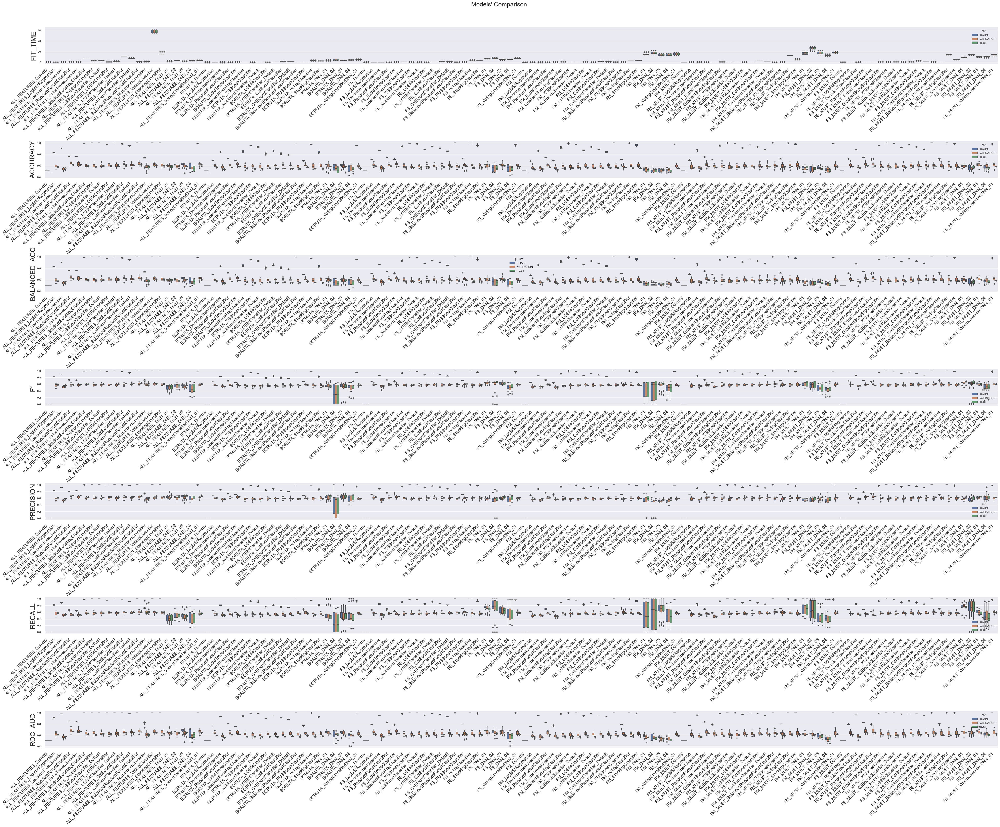

In [41]:
metrics = df_results_slim.select_dtypes(float).columns.to_list()

compare_model_results(
    df=df_results_slim,
    names="models",
    metrics=metrics,
    save_path=osp.join('figures','compare_models_slim.png'),
    hue='set'

)

# Analyzing the Results

In [42]:
df_results.sample(10)

,models,FIT_TIME,TEST_ACCURACY,TRAIN_ACCURACY,VALIDATION_ACCURACY,TEST_BALANCED_ACC,TRAIN_BALANCED_ACC,VALIDATION_BALANCED_ACC,TEST_F1,TRAIN_F1,VALIDATION_F1,TEST_PRECISION,TRAIN_PRECISION,VALIDATION_PRECISION,TEST_RECALL,TRAIN_RECALL,VALIDATION_RECALL,TEST_ROC_AUC,TRAIN_ROC_AUC,VALIDATION_ROC_AUC
3,ALL_FEATURES_BalancedRandomForestClassifier,0.84,0.61,1.00,0.62,0.61,1.00,0.62,0.62,1.00,0.60,0.64,1.00,0.61,0.60,1.00,0.60,0.66,1.00,0.67
498,FM_DecisionTreeClassifier,0.04,0.54,0.86,0.55,0.55,0.86,0.54,0.54,0.85,0.53,0.58,0.87,0.53,0.51,0.83,0.53,0.57,0.95,0.56
867,FS_CatBoostClassifier_Default,0.98,0.58,0.85,0.60,0.58,0.85,0.60,0.59,0.84,0.55,0.61,0.87,0.59,0.56,0.81,0.52,0.61,0.94,0.63
607,FM_MUST_DNN_02,27.48,0.58,0.59,0.57,0.57,0.59,0.57,0.63,0.62,0.62,0.59,0.56,0.53,0.68,0.71,0.74,0.61,0.63,0.61
1250,FS_XGBoostClassifier_Default,0.16,0.58,0.98,0.59,0.58,0.98,0.59,0.59,0.98,0.57,0.61,1.00,0.58,0.57,0.96,0.57,0.60,1.00,0.62
423,FM_BalancedRandomForestClassifier,0.31,0.57,1.00,0.60,0.57,1.00,0.60,0.59,1.00,0.57,0.59,1.00,0.58,0.58,1.00,0.56,0.60,1.00,0.63
545,FM_LGBMClassifier_Default,0.33,0.55,0.92,0.61,0.55,0.92,0.60,0.55,0.92,0.57,0.58,0.94,0.60,0.53,0.89,0.55,0.57,0.98,0.62
1164,FS_MUST_VotingClassifierDNN_01,14.27,0.59,0.97,0.53,0.59,0.97,0.53,0.61,0.97,0.54,0.61,0.98,0.51,0.61,0.96,0.58,0.63,1.00,0.56
440,FM_CatBoostClassifier_Default,0.93,0.56,0.83,0.62,0.56,0.83,0.62,0.56,0.82,0.60,0.59,0.85,0.61,0.53,0.79,0.58,0.58,0.92,0.64
956,FS_LGBMClassifier,0.24,0.57,0.89,0.59,0.57,0.89,0.59,0.57,0.88,0.56,0.60,0.92,0.58,0.54,0.85,0.54,0.60,0.96,0.61


In [43]:
df_results.groupby(['models']).mean().nlargest(10,'VALIDATION_ROC_AUC').sort_values('VALIDATION_ROC_AUC',ascending=False)

,FIT_TIME,TEST_ACCURACY,TRAIN_ACCURACY,VALIDATION_ACCURACY,TEST_BALANCED_ACC,TRAIN_BALANCED_ACC,VALIDATION_BALANCED_ACC,TEST_F1,TRAIN_F1,VALIDATION_F1,TEST_PRECISION,TRAIN_PRECISION,VALIDATION_PRECISION,TEST_RECALL,TRAIN_RECALL,VALIDATION_RECALL,TEST_ROC_AUC,TRAIN_ROC_AUC,VALIDATION_ROC_AUC
models,,,,,,,,,,,,,,,,,,,
ALL_FEATURES_RandomForestClassifier,0.44,0.62,0.76,0.64,0.62,0.76,0.63,0.59,0.73,0.58,0.68,0.81,0.65,0.51,0.66,0.53,0.67,0.85,0.68
ALL_FEATURES_ExtraTreesClassifier,0.44,0.62,0.76,0.63,0.62,0.76,0.62,0.58,0.72,0.57,0.69,0.82,0.64,0.51,0.64,0.51,0.67,0.84,0.68
FS_MUST_ExtraTreesClassifier,0.12,0.59,0.72,0.63,0.60,0.71,0.63,0.56,0.68,0.59,0.65,0.74,0.64,0.49,0.62,0.54,0.65,0.79,0.67
ALL_FEATURES_BalancedRandomForestClassifier,0.85,0.61,1.00,0.63,0.62,1.00,0.63,0.62,1.00,0.61,0.65,1.00,0.62,0.59,1.00,0.61,0.66,1.00,0.67
FS_MUST_RandomForestClassifier,0.17,0.60,0.74,0.63,0.60,0.74,0.63,0.59,0.72,0.59,0.65,0.76,0.63,0.54,0.68,0.55,0.64,0.83,0.67
FS_ExtraTreesClassifier,0.08,0.59,0.71,0.63,0.60,0.70,0.63,0.57,0.67,0.58,0.64,0.73,0.63,0.52,0.63,0.54,0.63,0.78,0.67
ALL_FEATURES_VotingClassifierDNN_01,3.52,0.61,0.99,0.62,0.61,0.99,0.62,0.60,0.99,0.58,0.65,1.00,0.62,0.56,0.99,0.55,0.64,1.00,0.66
FS_DNN_01,6.29,0.59,0.61,0.60,0.59,0.62,0.60,0.64,0.65,0.63,0.60,0.58,0.57,0.68,0.74,0.72,0.64,0.68,0.66
ALL_FEATURES_VotingClassifier,57.98,0.60,1.00,0.62,0.61,1.00,0.62,0.61,1.00,0.60,0.64,1.00,0.61,0.58,1.00,0.59,0.64,1.00,0.66


In [44]:
df_results.groupby(['models']).mean().nlargest(5,'VALIDATION_F1').sort_values('VALIDATION_F1',ascending=False)

,FIT_TIME,TEST_ACCURACY,TRAIN_ACCURACY,VALIDATION_ACCURACY,TEST_BALANCED_ACC,TRAIN_BALANCED_ACC,VALIDATION_BALANCED_ACC,TEST_F1,TRAIN_F1,VALIDATION_F1,TEST_PRECISION,TRAIN_PRECISION,VALIDATION_PRECISION,TEST_RECALL,TRAIN_RECALL,VALIDATION_RECALL,TEST_ROC_AUC,TRAIN_ROC_AUC,VALIDATION_ROC_AUC
models,,,,,,,,,,,,,,,,,,,
FS_MUST_DNN_01,9.10,0.60,0.60,0.59,0.59,0.60,0.60,0.66,0.64,0.64,0.60,0.56,0.56,0.73,0.76,0.77,0.64,0.66,0.65
FS_DNN_01,6.29,0.59,0.61,0.60,0.59,0.62,0.60,0.64,0.65,0.63,0.60,0.58,0.57,0.68,0.74,0.72,0.64,0.68,0.66
FS_DNN_03,5.47,0.60,0.62,0.61,0.60,0.62,0.61,0.62,0.62,0.62,0.63,0.59,0.59,0.63,0.67,0.66,0.64,0.67,0.66
ALL_FEATURES_BalancedRandomForestClassifier,0.85,0.61,1.00,0.63,0.62,1.00,0.63,0.62,1.00,0.61,0.65,1.00,0.62,0.59,1.00,0.61,0.66,1.00,0.67
ALL_FEATURES_VotingClassifier,57.98,0.60,1.00,0.62,0.61,1.00,0.62,0.61,1.00,0.60,0.64,1.00,0.61,0.58,1.00,0.59,0.64,1.00,0.66


In [45]:
df_results.groupby(['models']).mean().nlargest(5,'VALIDATION_BALANCED_ACC').sort_values('VALIDATION_BALANCED_ACC',ascending=False)

,FIT_TIME,TEST_ACCURACY,TRAIN_ACCURACY,VALIDATION_ACCURACY,TEST_BALANCED_ACC,TRAIN_BALANCED_ACC,VALIDATION_BALANCED_ACC,TEST_F1,TRAIN_F1,VALIDATION_F1,TEST_PRECISION,TRAIN_PRECISION,VALIDATION_PRECISION,TEST_RECALL,TRAIN_RECALL,VALIDATION_RECALL,TEST_ROC_AUC,TRAIN_ROC_AUC,VALIDATION_ROC_AUC
models,,,,,,,,,,,,,,,,,,,
ALL_FEATURES_RandomForestClassifier,0.44,0.62,0.76,0.64,0.62,0.76,0.63,0.59,0.73,0.58,0.68,0.81,0.65,0.51,0.66,0.53,0.67,0.85,0.68
ALL_FEATURES_BalancedRandomForestClassifier,0.85,0.61,1.00,0.63,0.62,1.00,0.63,0.62,1.00,0.61,0.65,1.00,0.62,0.59,1.00,0.61,0.66,1.00,0.67
FS_MUST_ExtraTreesClassifier,0.12,0.59,0.72,0.63,0.60,0.71,0.63,0.56,0.68,0.59,0.65,0.74,0.64,0.49,0.62,0.54,0.65,0.79,0.67
FS_ExtraTreesClassifier,0.08,0.59,0.71,0.63,0.60,0.70,0.63,0.57,0.67,0.58,0.64,0.73,0.63,0.52,0.63,0.54,0.63,0.78,0.67
FS_MUST_RandomForestClassifier,0.17,0.60,0.74,0.63,0.60,0.74,0.63,0.59,0.72,0.59,0.65,0.76,0.63,0.54,0.68,0.55,0.64,0.83,0.67


In [50]:
SELECTED_MODELS = sorted([col for col in results.keys() if 'Dummy' not in col and results[col]['ROC_AUC']['VALIDATION'].mean() > 0.65])
THRESHOLD = 0.5

In [51]:
# reading files

df_train=pd.read_parquet(osp.join(ALL_PATH, 'df_train.parquet'))
df_test=pd.read_parquet(osp.join(ALL_PATH, 'df_test.parquet'))

logger.info(f'df_train shape: {df_train.shape}')
logger.info(f'df_test shape: {df_test.shape}')   

X_train= df_train.drop([TARGET], axis=1)
y_train = df_train[TARGET]
X_test = df_test.drop([TARGET], axis=1)
y_test = df_test[TARGET]

In [52]:
predictions = {}
predictions_proba = {}
for name, model in trained_models.items():
    if name in SELECTED_MODELS:
        predictions[name] = model.predict(X_test)
        predictions_proba[name] = model.predict_proba(X_test)[:,1]

2023-09-21 08:19:42.123318: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-09-21 08:19:46.641939: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-09-21 08:19:47.859717: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-09-21 08:19:50.207146: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-09-21 08:19:51.094758: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-09-21 08:19:51.759804: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


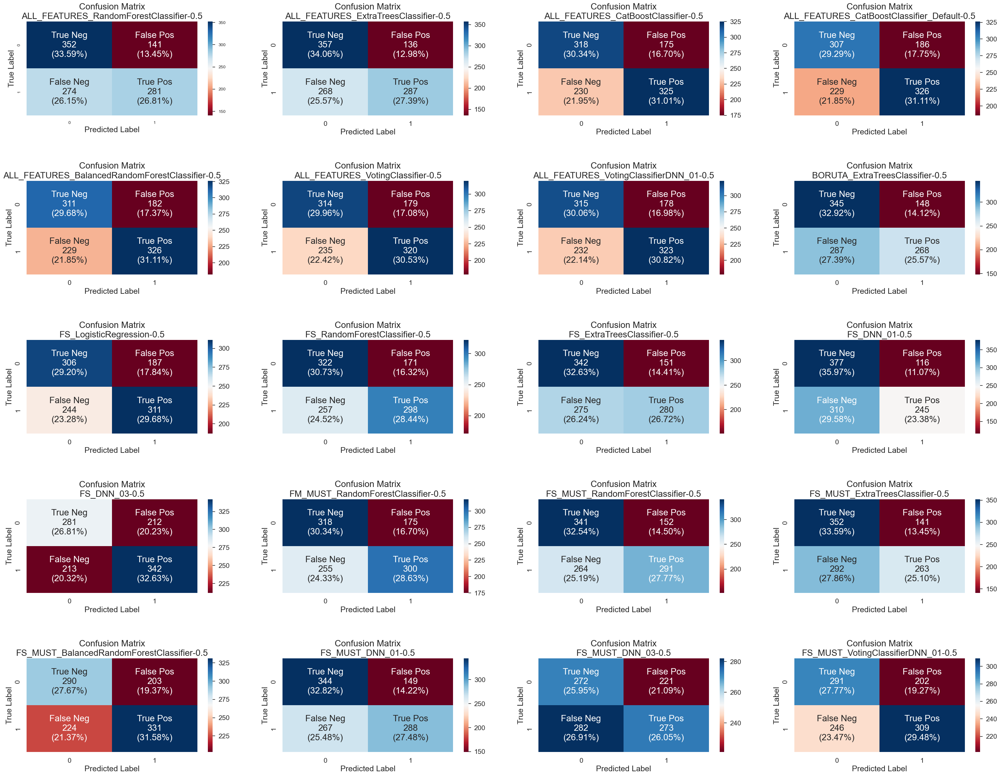

In [53]:
import matplotlib.pyplot as plt
import math

ncols = 4

size=len(predictions)
rows=math.ceil(size/ncols)
width, height = (10,6)

fig = plt.figure(figsize=(min(ncols*width, 50),rows*height))
fig.subplots_adjust(hspace=0.7, wspace=0.2)

for idx, (name, y_pred) in enumerate(predictions.items(), start=1):
    ax = fig.add_subplot(rows, ncols, idx)
    plot_confusion_matrix(y_real = y_test, y_pred= y_pred, title=f'Confusion Matrix\n{name}-{round(THRESHOLD,2)}', ax = ax)

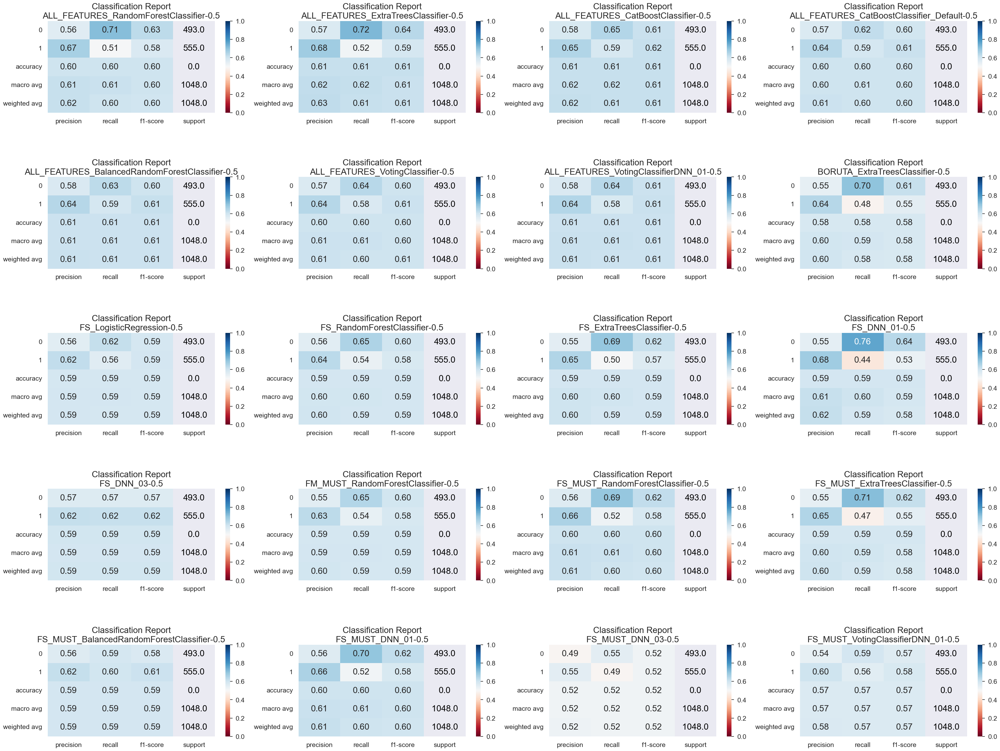

In [54]:
import matplotlib.pyplot as plt
import math

ncols = 4

size=len(predictions)
rows=math.ceil(size/ncols)
width, height = (10,6)

fig = plt.figure(figsize=(min(ncols*width, 50),rows*height))
fig.subplots_adjust(hspace=0.7, wspace=0.2)

for idx, (name, y_pred) in enumerate(predictions.items(), start=1):
    ax = fig.add_subplot(rows, ncols, idx)
    plot_classification_report_sns(y_real = y_test, y_pred= y_pred, title=f'Classification Report\n{name}-{round(THRESHOLD,2)}', ax = ax)

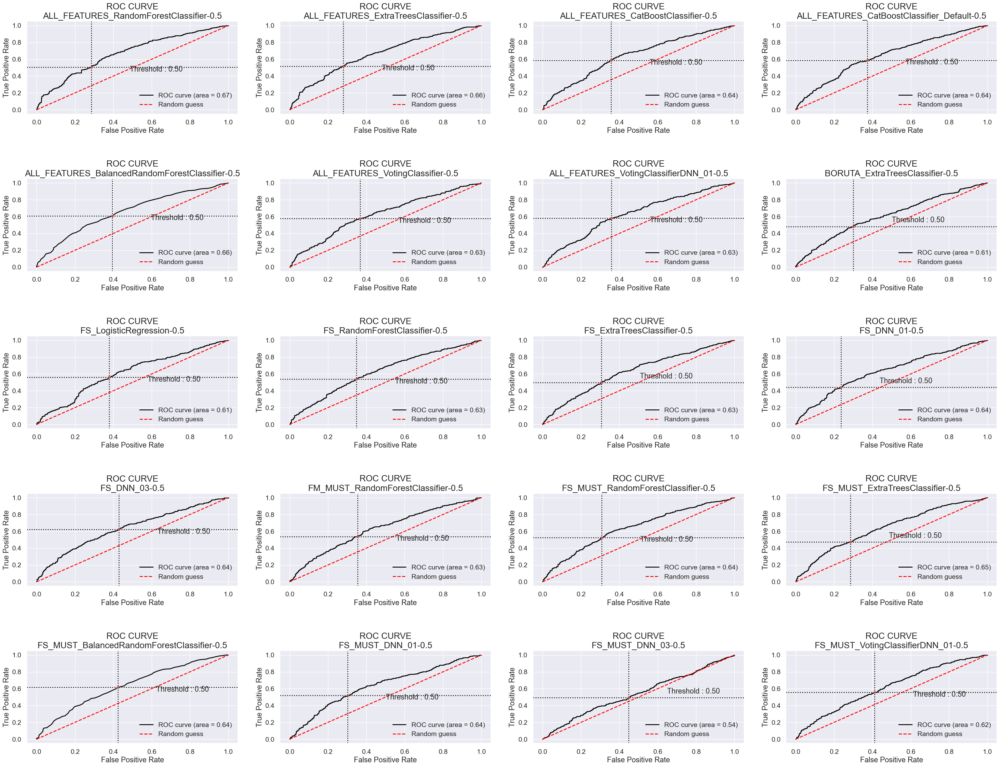

In [55]:
import matplotlib.pyplot as plt
import math

ncols = 4

size=len(predictions_proba)
rows=math.ceil(size/ncols)
width, height = (10,6)

fig = plt.figure(figsize=(min(ncols*width, 50),rows*height))
fig.subplots_adjust(hspace=0.7, wspace=0.2)

for idx, (name, y_pred) in enumerate(predictions_proba.items(), start=1):
    ax = fig.add_subplot(rows, ncols, idx)
    plot_roc_sns(y_real = y_test, y_pred= y_pred, title=f'ROC CURVE\n{name}-{round(THRESHOLD,2)}', ax = ax)

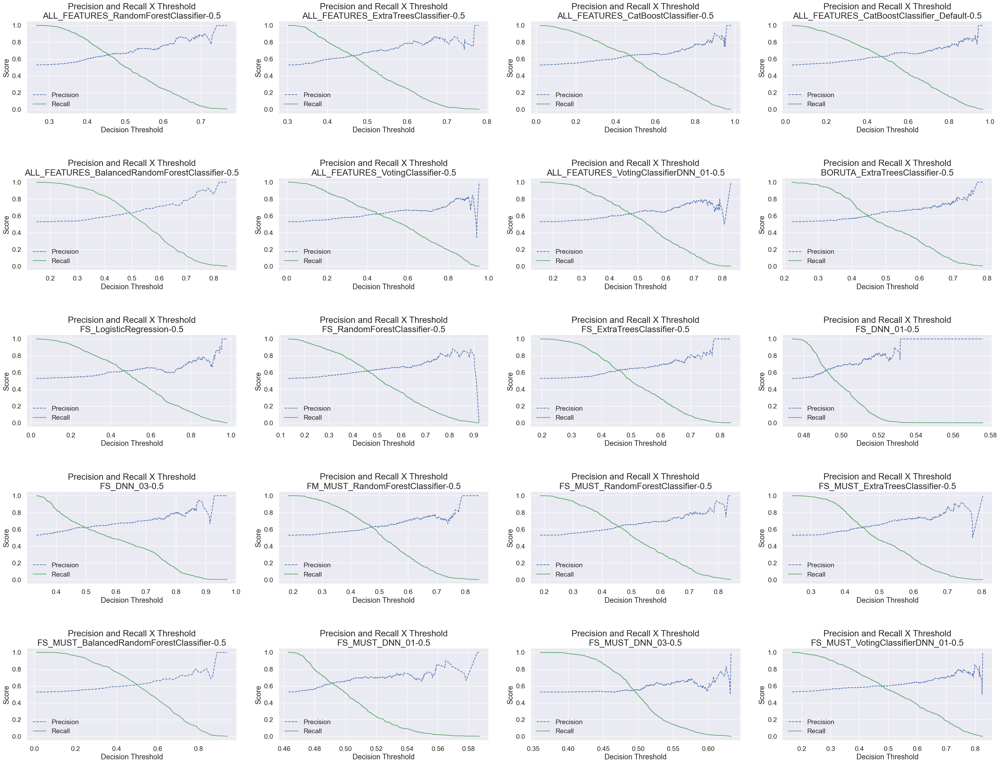

In [56]:
import matplotlib.pyplot as plt
import math

ncols = 4

size=len(predictions_proba)
rows=math.ceil(size/ncols)
width, height = (10,6)

fig = plt.figure(figsize=(min(ncols*width, 50),rows*height))
fig.subplots_adjust(hspace=0.7, wspace=0.2)

for idx, (name, y_pred) in enumerate(predictions_proba.items(), start=1):
    ax = fig.add_subplot(rows, ncols, idx)
    plot_precision_recall_vs_threshold(y_real = y_test, y_pred= y_pred, title=f'Precision and Recall X Threshold\n{name}-{round(THRESHOLD,2)}', ax = ax)

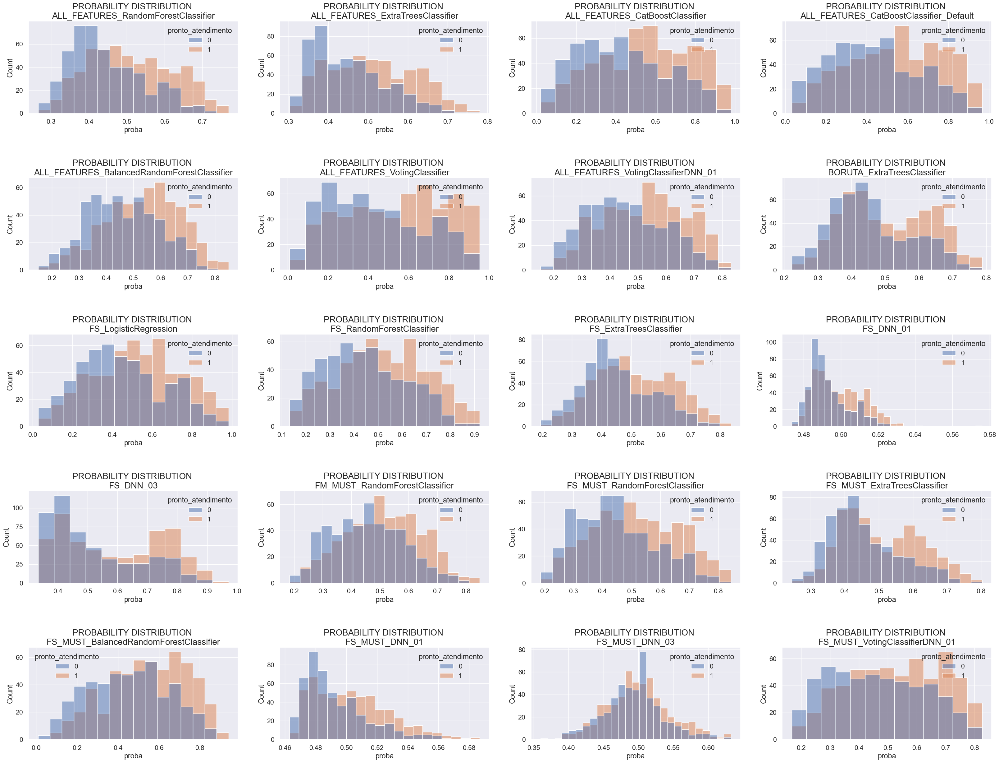

In [57]:
import seaborn as sns

ncols = 4

size=len(predictions_proba)
rows=math.ceil(size/ncols)
width, height = (10,6)

fig = plt.figure(figsize=(min(ncols*width, 50),rows*height))
fig.subplots_adjust(hspace=0.7, wspace=0.2)

for idx, (name, y_pred) in enumerate(predictions_proba.items(), start=1):
    ax = fig.add_subplot(rows, ncols, idx)
    df_proba = pd.concat([pd.Series(y_pred, name = 'proba', index = y_test.index), y_test], axis = 1)
    try:
        sns.histplot(data = df_proba, x = 'proba', hue = y_test.name, ax = ax)
        ax.set_title(f'PROBABILITY DISTRIBUTION \n{name}', fontsize=20)
    except:
        pass

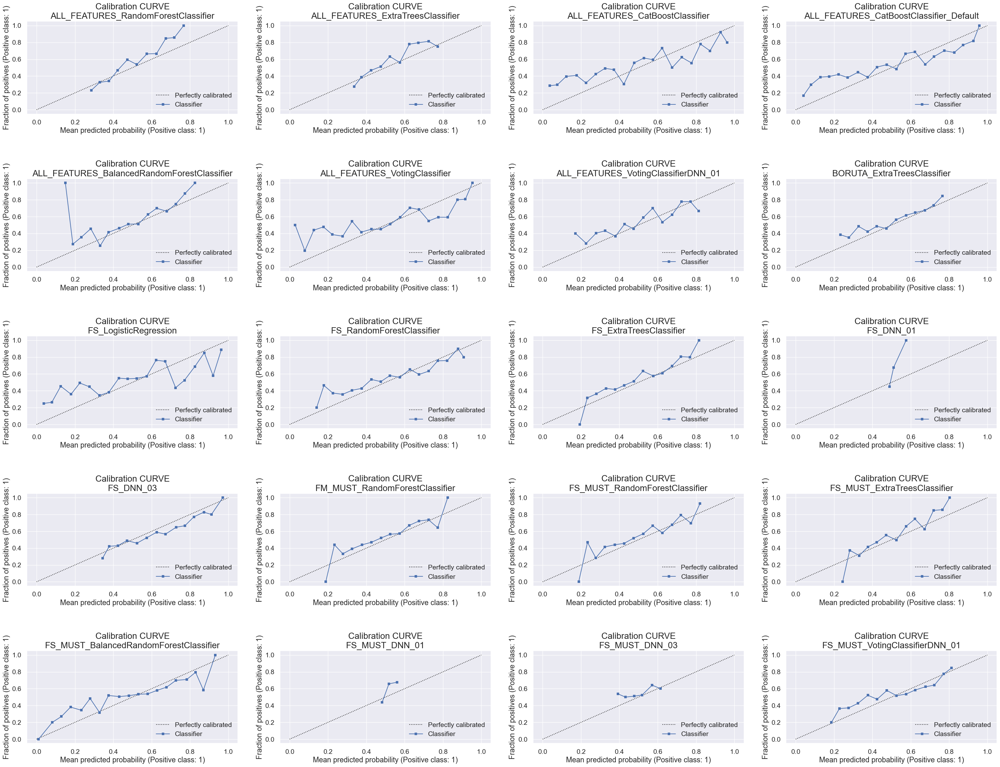

In [58]:
import matplotlib.pyplot as plt
import math

ncols = 4

size=len(predictions_proba)
rows=math.ceil(size/ncols)
width, height = (10,6)

fig = plt.figure(figsize=(min(ncols*width, 50),rows*height))
fig.subplots_adjust(hspace=0.7, wspace=0.2)

for idx, (name, y_pred) in enumerate(predictions_proba.items(), start=1):
    ax = fig.add_subplot(rows, ncols, idx)
    plot_calibration_curve(y_real = y_test, y_pred= y_pred, title=f'Calibration CURVE\n{name}', ax = ax, n_bins=20)

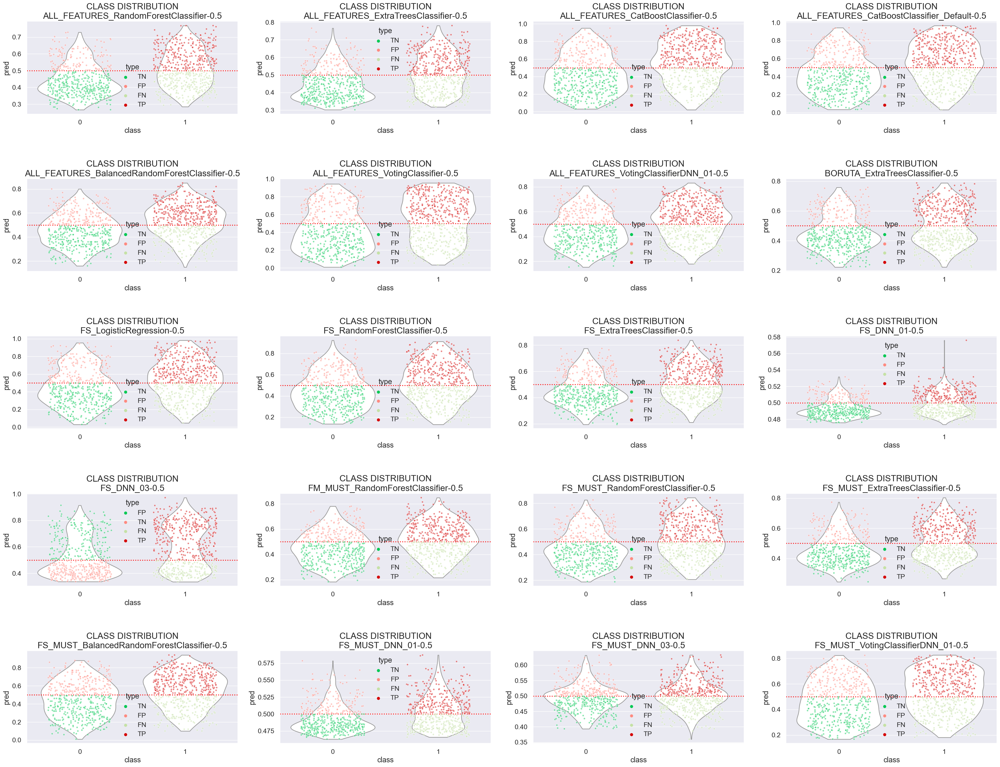

In [59]:
from plot_metric.functions import BinaryClassification
import matplotlib.pyplot as plt
import math

ncols = 4

size=len(predictions_proba)
rows=math.ceil(size/ncols)
width, height = (10,6)

fig = plt.figure(figsize=(min(ncols*width, 50),rows*height))
fig.subplots_adjust(hspace=0.7, wspace=0.2)

for idx, (name, y_pred) in enumerate(predictions_proba.items(), start=1):
    ax = fig.add_subplot(rows, ncols, idx)
    bc = BinaryClassification(y_true = y_test, y_pred= y_pred, labels=["Class 0", "Class 1"], threshold = THRESHOLD)
    bc.plot_class_distribution()
    title: ax.set_title(f'CLASS DISTRIBUTION\n{name}-{round(THRESHOLD,2)}', fontsize=20)

# Tunning Hyperparameters

In [ ]:
chosen_model_name = "BORUTA_LGBMClassifier"

chosen_model  = read_joblib(osp.join(MODELS_DIR, chosen_model_name ,'model.p'))
pipe = clone(chosen_model)

In [ ]:
# reading files

df_train=pd.read_parquet(osp.join(BORUTA_PATH, 'df_train.parquet'))
df_test=pd.read_parquet(osp.join(BORUTA_PATH, 'df_test.parquet'))

logger.info(f'df_train shape: {df_train.shape}')
logger.info(f'df_test shape: {df_test.shape}')   

X_train= df_train.drop([TARGET], axis=1)
y_train = df_train[TARGET]
X_test = df_test.drop([TARGET], axis=1)
y_test = df_test[TARGET]

In [ ]:
pipe

## Randomized Search CV

In [ ]:
preprocessor_search_space = {
    'preprocessor__float__imputer': [
        SimpleImputer(strategy="constant", fill_value=0),
        # SimpleImputer(strategy="constant", fill_value=np.nan),
        SimpleImputer(strategy="mean"),
        SimpleImputer(strategy="median"),                                                   
        # IterativeImputer(
        #     random_state=0
        #     , estimator=LGBMRegressor(max_depth = 3, random_state=SEED)
        #     , max_iter=10
        #     , tol=1e-1
        #     )
        ],
                
    'preprocessor__float__scaler': [
        FunctionTransformer(),            
        # FunctionTransformer(func = np.log1p, inverse_func = np.expm1),            
        PowerTransformer(method='yeo-johnson', standardize=False),            
        # PowerTransformer(method='box-cox', standardize=False),            
        MinMaxScaler(),
        StandardScaler()
        ],
    
    'preprocessor__int__imputer': [
        SimpleImputer(strategy="constant", fill_value=0),
        # SimpleImputer(strategy="constant", fill_value=np.nan),
        SimpleImputer(strategy="most_frequent"),
        SimpleImputer(strategy="mean"),
        SimpleImputer(strategy="median"),                                                   
        # IterativeImputer(
        #     random_state=0
        #     , estimator=LGBMRegressor(max_depth = 3, random_state=SEED)
        #     , max_iter=10
        #     , tol=1e-1
        #     )
        ],
    
    'preprocessor__int__scaler': [
        FunctionTransformer(),            
        # FunctionTransformer(func = np.log1p, inverse_func = np.expm1),            
        PowerTransformer(method='yeo-johnson', standardize=False),            
        # PowerTransformer(method='box-cox', standardize=False),            
        MinMaxScaler(),
        StandardScaler()
    ]
}

In [ ]:
search_space = [              
    {'model': [LGBMClassifier(random_state=SEED)],
        'model__n_estimators': [30, 100, 400, 700, 1000],
        'model__colsample_bytree': [0.7, 0.8],
        'model__max_depth': [3, 5, 10, 15, 20],
        'model__num_leaves': [50, 100, 200],
        'model__reg_alpha': [1.1, 1.2, 1.3],
        'model__reg_lambda': [1.1, 1.2, 1.3],
        'model__min_split_gain': [0.3, 0.4],
        'model__min_child_samples': [10, 20, 30, 40, 50],
        'model__subsample': [0.7, 0.8, 0.9],
        'model__subsample_freq': [20, 10],
    **preprocessor_search_space
    }
]

In [ ]:
SAMPLE_SIZE = 1000000

X_train_sample = X_train.sample(min(SAMPLE_SIZE,X_train.shape[0]))
# X_train_sample = X_train
y_train_sample = y_train.loc[X_train_sample.index]            

optimizer = None
optimizer=RandomizedSearch(pipe=pipe
            , search_space=search_space
            , X_train=X_train_sample
            , y_train=y_train_sample
            , scoring=metrics
            , refit = 'roc_auc'
            , n_iter=100
            , n_folds=N_FOLDS
            , verbose = 1
            )

print('Finished fitting optimizer')
best_model = optimizer.best_estimator_

print('Retraining best model')

best_model.fit(X_train, y_train)

write_joblib(best_model, osp.join(MODELS_DIR, 'best_model.joblib'))


In [ ]:
best_model

In [ ]:
y_pred_train = best_model.predict(X_train)
y_proba_train = best_model.predict_proba(X_train)
y_pred_test = best_model.predict(X_test)
y_proba_test = best_model.predict_proba(X_test)

max_metric_len = max([len(metric_name) for metric_name in metrics])
msg_metrics = f""
for metric_name, scorer in metrics.items():
    
    train_scorer = get_metric_result(
        scorer, y_train, y_pred_train,y_proba=y_proba_train
    )
    test_scorer = get_metric_result(
        scorer, y_test, y_pred_test, y_proba=y_proba_test
    )

    msg_metrics += f" - {metric_name.upper()}{' '*(max_metric_len-len(metric_name))}\t->\tTRAIN: {train_scorer:.2f} | TEST:{test_scorer:.2f}\n"
    
print(msg_metrics)

# Best Model

In [ ]:
best_model  = read_joblib(osp.join(MODELS_DIR, 'best_model.joblib'))

name = chosen_model_name

y_pred_train = best_model.predict(X_train)
y_proba_train = best_model.predict_proba(X_train)[:,1]
y_pred_test = best_model.predict(X_test)
y_proba_test = best_model.predict_proba(X_test)[:,1]

In [ ]:
y = y_test
y_pred = y_pred_test
y_proba = y_proba_test

## Metrics

### Precision and Recall x Threshold

In [ ]:
import matplotlib.pyplot as plt
import math

width, height = (10,6)

fig = plt.figure(figsize=(min(width, 50),height))
fig.subplots_adjust(hspace=0.7, wspace=0.2)

ax = fig.add_subplot(1, 1, 1)

plot_precision_recall_vs_threshold(y_real = y, y_pred= y_proba, title=f'Precision and Recall X Threshold\n{name}', ax = ax)

### Calibration Curve

In [ ]:
width, height = (10,6)

fig = plt.figure(figsize=(min(width, 50),height))
fig.subplots_adjust(hspace=0.7, wspace=0.2)

ax = fig.add_subplot(1, 1, 1)

plot_calibration_curve(y_real = y, y_pred= y_proba, title=f'Calibration CURVE\n{name}', ax = ax, n_bins=20)

### Probability Distribution

In [ ]:
width, height = (10,6)

fig = plt.figure(figsize=(min(width, 50),height))
fig.subplots_adjust(hspace=0.7, wspace=0.2)

ax = fig.add_subplot(1, 1, 1)

df_proba = pd.concat([pd.Series(y_proba, name = 'proba', index = y.index), y], axis = 1)

sns.histplot(data = df_proba, x = 'proba', hue = y.name, ax = ax)
ax.set_title(f'PROBABILITY DISTRIBUTION \n{name}', fontsize=20)

plt.show()

### Confusion Matrix x Threshold

In [ ]:
import matplotlib.pyplot as plt
import math

ncols = 5
THRESHOLDS = np.arange(0.05,1.05,0.05)

size=len(THRESHOLDS)
rows=math.ceil(size/ncols)
width, height = (10,6)

fig = plt.figure(figsize=(min(ncols*width, 50),rows*height))
fig.subplots_adjust(hspace=0.7, wspace=0.2)

for idx, threshold in enumerate(THRESHOLDS, start=1):
    ax = fig.add_subplot(rows, ncols, idx)
    y_pred_threshold = best_model.predict_proba(X_test)[:,1]>threshold
    plot_confusion_matrix(y_real = y, y_pred= y_pred_threshold, title=f'Confusion Matrix\n{name}-{round(threshold,2)}', ax = ax)

### Classification Report x Threshold

In [ ]:
import matplotlib.pyplot as plt
import math

ncols = 5
THRESHOLDS = np.arange(0.05,1.05,0.05)

size=len(THRESHOLDS)
rows=math.ceil(size/ncols)
width, height = (10,6)

fig = plt.figure(figsize=(min(ncols*width, 50),rows*height))
fig.subplots_adjust(hspace=0.7, wspace=0.2)

for idx, threshold in enumerate(THRESHOLDS, start=1):
    ax = fig.add_subplot(rows, ncols, idx)
    y_pred_threshold = best_model.predict_proba(X_test)[:,1]>threshold
    plot_classification_report_sns(y_real = y, y_pred= y_pred_threshold, title=f'Classification Report\n{name}-{round(threshold,2)}', ax = ax)

### Defining Threshold

In [ ]:
THRESHOLD = 0.35
y_pred = best_model.predict_proba(X_test)[:,1]>THRESHOLD

### Confusion Matrix

In [ ]:
plot_confusion_matrix(y_real =y, y_pred= y_pred, title=f'Confusion Matrix\n{name}-{round(THRESHOLD,2)}')

### Classification Report

In [ ]:
plot_classification_report_sns(y_real = y, y_pred= y_pred, title=f'Classification Report\n{name}-{round(THRESHOLD,2)}')

### Roc Curve

In [ ]:
from plot_metric.functions import BinaryClassification
f, ax = plt.subplots(figsize=(10,6 ))
bc = BinaryClassification(y_true = y, y_pred= y_proba, labels=["Class 1", "Class 2"], threshold = THRESHOLD)
bc.plot_roc_curve()
title: ax.set_title(f'ROC CURVE\n{name}-{round(THRESHOLD,2)}', fontsize=20)

### Precision x Recall

In [ ]:
from plot_metric.functions import BinaryClassification
f, ax = plt.subplots(figsize=(10,6 ))
bc = BinaryClassification(y_true = y, y_pred= y_proba, labels=["Class 0", "Class 1"], threshold = THRESHOLD)
bc.plot_precision_recall_curve()
title: ax.set_title(f'PRECISION X RECALL\n{name}-{round(THRESHOLD,2)}', fontsize=20)

### Class Distribution

In [ ]:
from plot_metric.functions import BinaryClassification
f, ax = plt.subplots(figsize=(10,6 ))
bc = BinaryClassification(y_true = y, y_pred= y_proba, labels=["Class 0", "Class 1"], threshold = THRESHOLD)
bc.plot_class_distribution()
title: ax.set_title(f'CLASS DISTRIBUTION\n{name}-{round(THRESHOLD,2)}', fontsize=20)

## Shap

In [ ]:
import shap

shap.initjs()

model = best_model

# Using a random sample of the dataframe for better time computation
X_train_sampled = X_train.sample(30, random_state=10)
X_test_sampled = X_test.sample(1000, random_state=10)

# explain the model's predictions using SHAP values
def model_predict(data_asarray, model = model, columns=X_train_sampled.columns):
    data_asframe = pd.DataFrame(data_asarray, columns=columns)
    predictions = model.predict_proba(data_asframe)
    return predictions

explainer = shap.KernelExplainer(model = model_predict, data = X_train_sampled, link = "identity")
shap_values = explainer.shap_values(X_test_sampled)

In [ ]:
shap.summary_plot(shap_values[1], X_test_sampled, plot_size = (18,10))

In [ ]:
shap.force_plot(explainer.expected_value[0], shap_values[0][0], feature_names = X_train_sampled.columns, link = 'logit')

In [ ]:
shap.plots._waterfall.waterfall_legacy(explainer.expected_value[1], shap_values[1][0], feature_names= X_train_sampled.columns)

In [ ]:
shap.summary_plot(shap_values, plot_type = 'bar', feature_names = X_train_sampled.columns, plot_size=(18,10))

In [ ]:
shap.decision_plot(explainer.expected_value[1], shap_values[1][:500], feature_names = X_test_sampled.columns.to_list(), xlim = (-0.1,1),
                   feature_order = 'hclust')

In [ ]:
shap.plots.force(explainer.expected_value[1], shap_values[1], feature_names = X_test_sampled.columns.to_list())